# Машинное обучение, ВМК МГУ

# Практическое задание 2. Обучение без учителя.

## Общая информация
Дата выдачи: 19.03.2023

Мягкий дедлайн: 03.04.2021 23:59 MSK **(за каждый день просрочки снимается 1 балл)**

Жёсткий дедлайн: 10.04.2021 23:59 MSK

## Оценивание и штрафы

Каждая из задач имеет определенную «стоимость» (указана в скобках около задачи). Максимально допустимая оценка за работу — **10 баллов + 4.4 бонусов**.

Сдавать задание после указанного срока сдачи нельзя. При выставлении неполного балла за задание в связи с наличием ошибок на усмотрение проверяющего предусмотрена возможность исправить работу на указанных в ответном письме условиях.

Задание выполняется самостоятельно. «Похожие» решения считаются плагиатом и все задействованные студенты (в том числе те, у кого списали) не могут получить за него больше 0 баллов (подробнее о плагиате см. на странице курса). Если вы нашли решение какого-то из заданий (или его часть) в открытом источнике, необходимо указать ссылку на этот источник в отдельном блоке в конце вашей работы (скорее всего вы будете не единственным, кто это нашел, поэтому чтобы исключить подозрение в плагиате, необходима ссылка на источник).

Неэффективная реализация кода может негативно отразиться на оценке.

## Формат сдачи
Задания сдаются через систему anytask. Посылка должна содержать:
* Ноутбук homework-practice-02-Username.ipynb

Username — ваша фамилия на латинице

<p style="color:#de3815;font-size:25px;">
Напоминание об оформлении и выполнении ноутбука
</p>

* Все строчки должны быть выполнены. Нужно, чтобы output команды можно было увидеть, не запуская ячейки (кроме редких случаев, когда необходимо намеренно скрыть ненужный output, про такие случаи желательно писать пояснения в тексте). **В противном случае -1 балл**
* При оформлении ДЗ нужно пользоваться данным файлом в качестве шаблона. Не нужно удалять и видоизменять написанный код и текст, если явно не указана такая возможность. **В противном случае -1 балл**
* В anytask обязательно нужно прикреплять отдельно файл с расширением ipynb (не в архиве, а именно отдельно). Если необходимо отправить еще какие-то файлы, то вынесите их в отдельный архив (если файлов много) и пришлите. **В противном случае -0.5 балла**
---
* Пишите, пожалуйста, выводы и ответы на вопросы в текстовых ячейках/при помощи print в коде. При их отсутствии мы не можем понять, сделали ли вы задание и понимаете, что происходит, и **поэтому будем снижать баллы**
* Если алгоритм не сказано реализовывать явно, его всегда можно импортировать из библиотеки.
---
* Про графики. _Штрафы будут применяться к каждому результату команды отображения графика (plt.show() и др. аналогичные). Исключением являются графики, генерируемые функциями каких-либо сторонних библиотек, если их нельзя кастомизировать_

    * должно быть название (plt.title) графика; **В противном случае &ndash; -0.05 балла**
    * на графиках должны быть подписаны оси (plt.xlabel, plt.ylabel); **В противном случае &ndash; -0.025 балла за каждую ось**
    * должны быть подписаны единицы измерения (если это возможно); **В противном случае &ndash; -0.025 балла за каждую ось**
    * все названия должны быть понятны любому человеку, знакомому с терминологией, без заглядывания в код; **В противном случае &ndash; -0.05 балла**
    * подписи тиков на осях не должны сливаться как на одной оси, так и между ними; **В противном случае &ndash; -0.025 балла за каждую ось**
    * если изображено несколько сущностей на одном холсте (например несколько функций), то необходима поясняющая легенда (plt.legend); **В противном случае &ndash; -0.05 балла**
    * все линии на графиках должны быть чётко видны (нет похожих цветов или цветов, сливающихся с фоном); **В противном случае &ndash; -0.05 балла**
    * если отображена величина, имеющая очевидный диапазон значений (например, проценты могут быть от 0 до 100), то желательно масштабировать ось на весь диапазон значений (исключением является случай, когда вам необходимо показать малое отличие, которое незаметно в таких масштабах);
    * графики должны быть не супер-микро и не супер-макро по размерам, так, чтобы можно было увидеть все, что нужно.
    * при необходимости улучшения наглядности графиков, можно пользоваться логарифмической шкалой по осям x/y.
    

### А также..

* Для удобства поиска вопросов, на которые от вас просят ответа, мы пометили их знаком **(?)**
* Знак **(!)** означает, что выполнение замечания необходимо для **возможности получения полного балла**
* Даем до +0.3 баллов за выдающиеся успехи по субъективному мнению проверяющих. Этот **бонус** не апеллируется

## О задании

В этом задании мы посмотрим на несколько алгоритмов кластеризации и применим их к географическим и текстовым данным. Также мы подробно остановимся на тематическом моделировании текстов, задаче обучения представлений и в каком-то смысле поработаем с semi-supervised learning. 



**Замечание:**
* seed менять нежелательно

In [3]:
import pandas as pd
import numpy as np
from sklearn.metrics.pairwise import haversine_distances
from copy import copy
import seaborn as sns
import branca
import branca.colormap as cm
from sklearn.cluster import DBSCAN
from sklearn.metrics import silhouette_score
from tqdm import tqdm
from sklearn.feature_extraction.text import TfidfVectorizer
from sklearn.manifold import TSNE
from sklearn.cluster import SpectralClustering
from sklearn.decomposition import LatentDirichletAllocation as LDA
from sklearn.feature_extraction.text import CountVectorizer
from sklearn.linear_model import LogisticRegression
from sklearn.model_selection import train_test_split

import matplotlib_inline
import matplotlib.pyplot as plt

%matplotlib inline
matplotlib_inline.backend_inline.set_matplotlib_formats('pdf', 'svg')
import matplotlib.ticker as ticker

np.random.seed(0xFFFFFFF)

## Часть 1. Кластеризация автобусных остановок

В этом задании мы сравним разные алгоритмы кластеризации для данных об автобусных остановках Москвы.

**Задание 1.1 (1 балл).** Реализуйте алгоритм спектральной кластеризации, который упоминался на лекции/семинаре. Для этого разберитесь с кодом шаблона, данного ниже, и допишите недостающую функцию. Напомним, что для графа с матрицей смежности $W = \{w_{ij}\}_{i, j = 1 \dots \ell}$ лапласиан определяется как:

$$
L = D - W,
$$

где $D = \text{diag}(d_1, ..., d_{\ell}), d_i = \sum_{j=1}^{\ell} w_{ij}$.

In [23]:
from sklearn.base import ClusterMixin
from sklearn.cluster import KMeans


class GraphClustering(ClusterMixin):
    def __init__(self, n_clusters=8, n_components=None, **kwargs):
        '''
        Spectral clustering algorithm
        param n_clusters: number of clusters to form
        param n_components: number of eigenvectors to use
        '''

        if n_components is None:
            n_components = n_clusters

        self.n_components = n_components
        self.kmeans = KMeans(n_clusters=n_clusters, **kwargs)

    def fit_predict(self, X, y=None):
        '''
        Perform spectral clustering from graph adjacency matrix
        and return vertex labels.
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, ) - vertex labels
        '''

        eigenvectors = self._generate_eigenvectors(X)
        labels = self.kmeans.fit_predict(eigenvectors[:, 1:])
        return labels

    def _generate_eigenvectors(self, X):
        '''
        Compute eigenvectors for spectral clustering
        param X: (n_samples, n_samples) - graph adjacency matrix
        return: (n_samples, n_components) - eigenvectors
        '''

        # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
        D = np.diag(np.sum(X, axis=1))
        L = D - X
        lambdas, vectors = np.linalg.eig(L)
        vectors = vectors.real[:, lambdas.imag == 0]
        lambdas = lambdas.real[lambdas.imag == 0]
        ind = np.argsort(lambdas)[0:self.n_components]
        eigenvectors = vectors[:, ind]
        return eigenvectors

Перед тем, как переходить к следующему заданию, протестируйте свое решение.

In [128]:
n_blocks, n_vertices = 10, 1000
block_vertices = n_vertices // n_blocks

X = np.zeros((n_vertices, n_vertices))
for i in range(0, n_vertices, block_vertices):
    X[i:i + block_vertices, i:i + block_vertices] = np.sqrt(i + 1)

graph_clustering = GraphClustering(n_clusters=n_blocks)
labels = graph_clustering.fit_predict(X)

true_labels = np.zeros(n_vertices, dtype=np.int32)
for i in range(0, n_vertices, block_vertices):
    true_labels[i:i + block_vertices] = labels[i]

assert labels.shape == (n_vertices, )
assert np.all(np.bincount(labels) == np.full(n_blocks, block_vertices))
assert np.all(labels == true_labels)

**Замечание**
* Для возможности получения **полного балла** assert должны проходить

Теперь можем приступить к работе с реальными данными. Скачайте файл с данными об остановках общественного транспорта **в формате .xlsx** по [ссылке](https://data.mos.ru/opendata/download/60464/1/201) (так гарантированно не возникнет проблем с парсингом файла) и загрузите таблицу в ноутбук. Если вдруг сайт Правительства Москвы сойдет с ума, то возьмите какую-нибудь версию данных [отсюда](https://data.mos.ru/opendata/7704786030-city-surface-public-transport-stops). Для удобства визуализации мы будем работать только с остановками в ЦАО.

**Замечание**
* Данные скачаны по первой ссылке, но названы не 'transport.xlsx', как указано в следующей ячейке, а 'City surface public transport stops.xlsx'.

In [129]:
data = pd.read_excel('City surface public transport stops.xlsx')
data = data[data.AdmArea_en == "Czentral`ny'j administrativny'j okrug"]
data = data.reset_index()
data.head()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
0,278,347,"«2-й Лесной пер.», улица Бутырский Вал (347)",37.586584,55.782106,улица Бутырский Вал,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ18; А12; АТ56; АТ78,2-й Лесной пер.,NaN,да,ГУП «Мосгортранс»,active,889085436,NaN
1,279,349,"«Ул. Сущевский Вал», Новослободская улица (349)",37.590714,55.790630,Новослободская улица,Czentral`ny'j administrativny'j okrug,Tverskoj rajon,АТ47; АМ10; АТ3; АТ56; АТ78,Ул. Сущевский Вал,NaN,да,ГУП «Мосгортранс»,active,889085437,NaN
2,355,479,"«Стадион Лужники (южн.) (пос.)», улица Лужники...",37.565972,55.714265,улица Лужники,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Стадион Лужники (южн.) (пос.),NaN,да,ГУП «Мосгортранс»,active,889085549,NaN
3,356,480,"«Спортзал Дружба», Лужнецкая набережная (480)",37.570191,55.712504,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Спортзал Дружба,NaN,да,ГУП «Мосгортранс»,active,889085550,NaN
4,357,481,"«Лужнецкая наб.», Лужнецкая набережная (481)",37.574559,55.713770,Лужнецкая набережная,Czentral`ny'j administrativny'j okrug,rajon Xamovniki,А64; А216; А809; АС12; А255; АБК; АТ79,Лужнецкая наб.,NaN,да,ГУП «Мосгортранс»,active,889085551,NaN


In [113]:
data['RouteNumbers_en'][0]

'АТ18; А12; АТ56; АТ78'

In [124]:
data[data['ID_en'] == 33]

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData


In [74]:
data.shape

(1037, 16)

In [75]:
data.tail()

,index,ID_en,Name_en,Longitude_WGS84_en,Latitude_WGS84_en,Street_en,AdmArea_en,District_en,RouteNumbers_en,StationName_en,Direction_en,Pavilion_en,OperatingOrgName_en,EntryState_en,global_id,geoData
1032,11686,5099,"«Садовническая ул.», Садовническая улица (5099)",37.637040,55.745463,Садовническая улица,Czentral`ny'j administrativny'j okrug,rajon Zamoskvorech`e,АК,Садовническая ул.,NaN,да,ГУП «Мосгортранс»,active,1068963581,NaN
1033,11707,1009191,"«Ваганьковское кладб.», улица Сергея Макеева (...",37.554929,55.768215,улица Сергея Макеева,Czentral`ny'j administrativny'j okrug,Presnenskij rajon,А869,Ваганьковское кладб.,NaN,нет,NaN,active,1069801667,NaN
1034,11714,1009193,"«Метро Рижская», проспект Мира (1009193)",37.634917,55.793561,проспект Мира,Czentral`ny'j administrativny'j okrug,Meshhanskij rajon,АМ71,Метро Рижская,NaN,нет,NaN,active,1069801674,NaN
1035,11717,1009239,"«Метро Октябрьская», улица Шаболовка (1009239)",37.612374,55.725723,улица Шаболовка,Czentral`ny'j administrativny'j okrug,rajon Yakimanka,АО47,Метро Октябрьская,NaN,нет,NaN,active,1069801677,NaN
1036,11736,1009192,"«Ул. Сергея Макеева», улица Сергея Макеева (10...",37.552729,55.765403,улица Сергея Макеева,Czentral`ny'j administrativny'j okrug,Presnenskij rajon,А869,Ул. Сергея Макеева,NaN,нет,NaN,active,1069801706,NaN


In [33]:
pip install folium

Note: you may need to restart the kernel to use updated packages.  Downloading branca-0.4.2-py3-none-any.whl (24 kB)



Воспользуемся библиотекой `folium` для визуализации данных.

In [5]:
import folium

map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for id, row in data.iterrows():
    folium.Circle([row.Latitude_WGS84_en, row.Longitude_WGS84_en],
                  radius=10).add_to(map_)
map_

**Задание 1.2 (1 балл).** Попробуем построить граф, в котором вершинами будут остановки. Как вы уже могли заметить, для каждой остановки указаны номера маршрутов, проходящих через неё. Логично соединить ребрами соседние остановки каждого маршрута. Однако мы не знаем, в каком порядке автобусы объезжают остановки. Но мы можем применить эвристический алгоритм, который восстановит нам порядок маршрутов:

* Для каждого маршрута выделим список всех остановок, через которые он проходит.
* Выберем начальную остановку маршрута как точку, наиболее удаленную от всех остальных остановок этого маршрута.
* Каждую следующую точку маршрута будем выбирать из оставшихся (не включенных еще в маршрут) точек, как самую близкую к последней найденной точке (последней, включенной в маршрут)

Фактически, у нас получается жадное решение задачи коммивояжера. Когда мы отсортировали маршруты, можем построить по ним граф. Будем строить его по таким правилам:

* Между двумя остановками будет ребро, если они являются соседними хотя бы на одном маршруте. Вес ребра равен числу маршрутов, на которых остановки являются соседними.
* В графе не будет петель (то есть у матрицы смежности будет нулевая диагональ).

Реализуйте предложенный способ построения графа. Для этого рекомендуется воспользоваться шаблонами, приведенными ниже.

In [130]:
def get_routes(data):
    '''
    Accumulate routes from raw data
    param data: pd.DataFrame - public transport stops data
    return: dict - unsorted stops ids for each route,
                   e.g. routes['A1'] = [356, 641, 190]
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    stops = dict()
    for ind, st in data.iterrows():
        for num in st['RouteNumbers_en'].split(';'):
            if num.strip() in stops:
                #stops[num.strip()].append(data.loc[ind, 'ID_en'])
                stops[num.strip()].append(ind)
            else:
                #stops[num.strip()] = [data.loc[ind, 'ID_en']]
                stops[num.strip()] = [ind]
    for key in stops:
        stops[key] = list(np.unique(np.array(stops[key])))
    #print(len(stops.keys()))
    return stops


def sort_routes(data, routes):
    '''
    Sort routes according to the proposed algorithm
    param data: pd.DataFrame - public transport stops data
    param routes: dict - unsorted stops ids for each route
    return: dict - sorted stops ids for each route
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    result = dict()
    all_stops = data[['Longitude_WGS84_en', 'Latitude_WGS84_en']].to_numpy()
    dist = haversine_distances(all_stops, all_stops)
    #print(dist.shape)
    stops_nums = dict()
    for ind, st in data.iterrows():
        #stops_nums[st['ID_en']] = ind
        stops_nums[ind] = ind
    for route in routes:
        #print('Hello')
        cur_stops = copy(routes[route])
        stops_indexes = []
        for cs in cur_stops:
            stops_indexes.append(stops_nums[cs])
        stops_indexes = sorted(stops_indexes)
        #print(stops_indexes)
        new_stops = []
        #find first stop
        cur_dist = copy(dist[stops_indexes, :])
        cur_dist = copy(cur_dist[:, stops_indexes])
        #print(cur_dist.shape)
        first = np.argmax(np.sum(cur_dist, axis=1))
        #new_stops.append(data.loc[stops_indexes[first], 'ID_en'])
        new_stops.append(stops_indexes[first])
        stops_indexes.pop(first)
        cur_dist = np.delete(cur_dist, first, axis=1)
        find_str = copy(cur_dist[first])
        cur_dist = np.delete(cur_dist, first, axis=0)
        while len(stops_indexes) != 0:
            near = np.argmin(find_str)
            #new_stops.append(data.loc[stops_indexes[near], 'ID_en'])
            new_stops.append(stops_indexes[near])
            stops_indexes.pop(near)
            cur_dist = np.delete(cur_dist, near, axis=1)
            find_str = copy(cur_dist[near])
            cur_dist = np.delete(cur_dist, near, axis=0)
        result[route] = copy(new_stops)
    return result  


def get_adjacency_matrix(data, sorted_routes):
    '''
    Compute adjacency matrix for sorted routes
    param data: pd.DataFrame - public transport stops data
    param sorted_routes: dict - sorted stops ids for each route
    return: (n_samples, n_samples) - graph adjacency matrix
    '''
    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    n = data.shape[0]
    result = np.zeros((n, n))
    stops_nums = dict()
    for ind, st in data.iterrows():
        #stops_nums[st['ID_en']] = ind
        stops_nums[ind] = ind
    for route in sorted_routes:
        for i in range(len(sorted_routes[route]) - 1):
            col = sorted_routes[route][i]
            row = sorted_routes[route][i + 1]
            col = stops_nums[col]
            row = stops_nums[row]
            result[row][col] += 1
            result[col][row] += 1
    return result

In [131]:
routes = get_routes(data)
sorted_routes = sort_routes(data, routes)
adjacency_matrix = get_adjacency_matrix(data, sorted_routes)
len(sorted_routes)

163

In [142]:
routes['А38']

[33,
 110,
 111,
 112,
 113,
 299,
 384,
 386,
 387,
 408,
 458,
 565,
 711,
 713,
 715,
 716,
 717,
 718,
 719,
 832,
 833,
 875,
 881,
 882,
 883,
 898,
 899,
 900,
 909,
 959,
 960]

In [105]:
sorted_routes['А294']

[542, 588, 543, 799, 798, 47, 48]

Проверим, что маршруты получились адекватными. Для этого нарисуем их на карте.

In [10]:
map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
for route_id in np.random.choice(list(sorted_routes.keys()), size=5):
    coords = data.loc[
        sorted_routes[route_id],
        ['Latitude_WGS84_en', 'Longitude_WGS84_en']
    ].values.tolist()
    folium.vector_layers.PolyLine(coords).add_to(map_)

map_

**Задание 1.3 (0 баллов)**. Реализуйте функцию `draw_clustered_map`, которая рисует карту центра Москвы с кластерами остановок, раскрашенными в разные цвета.

In [132]:
def draw_clustered_map(data, labels):
    '''
    Create map with coloured clusters
    param data: pd.DataFrame - public transport stops data
    param labels: (n_samples, ) - cluster labels for each stop
    return: folium.Map - map with coloured clusters
    '''

    # YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
    map_ = folium.Map([55.75215, 37.61819], zoom_start=12)
    color_pallete = sns.color_palette()
    color_pallete = sns.color_palette("bright", 1037)
    color_pallete = color_pallete.as_hex()
    colormap = cm.LinearColormap(colors=color_pallete, index=labels)
    lat = list(data['Latitude_WGS84_en'])
    lon = list(data['Longitude_WGS84_en'])
    
    for loc, p in zip(zip(lat, lon), labels):
        folium.Circle(
            location=loc,
            radius=30,
            fill=True,
            color=color_pallete[p],
            #fill_opacity=0.7
        ).add_to(map_)
    return map_

# https://www.stackfinder.ru/questions/66816984/colors-assosiated-with-dataframe-column-in-folium
# https://question-it.com/questions/3435678/ne-znaete-kak-ispolzovat-tsvetovuju-kartu-s-grafikom-markera-folium?ysclid=l1j1wwm8ep

**Задание 1.4 (1.5 балла)**. 

* **(0.25 балла)** Примените алгоритмы кластеризации K-Means и DBSCAN из `sklearn` на координатах остановок, а также свою реализацию спектральной кластеризации на построенной выше матрице смежности. В этом пункте используйте дефолтные параметры.
* **(0.25 балла)** Визуализируйте результат кластеризации из предыдущего пункта с помощью функции `draw_clustered_map`.
* **(0.75 балла)** А теперь подберите с помощью **кросс-валидации** параметры алгоритмов (`n_clusters` у K-Means, `eps` у DBSCAN, `n_clusters` и `n_components` у спектральной кластеризации) так, чтобы получить наиболее характерный для этих алгоритмов результат кластеризации. В качестве метрики качества можете использовать `silhouette_score`. Визуализируйте полученные результаты для всех трех алгоритмов на *оптимальных параметрах*
* (?) Проинтерпретируйте полученные результаты.
 * **(0.1 балла)** Чем отличаются разбиения на кластеры, получаемые разными алгоритмами?
 * **(0.1 балла)** Какие плюсы и минусы есть у каждого алгоритма?
 * **(0.05 балла)** Какой алгоритм кажется вам наиболее подходящим для кластеризации остановок?

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).
* Обращайте внимание на баланс объектов в кластерах.

In [18]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
kmeans = KMeans()
km_res = kmeans.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])

In [47]:
draw_clustered_map(data, km_res)

In [21]:
dbscan = DBSCAN()
db_res = dbscan.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])

In [51]:
db_res

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [49]:
draw_clustered_map(data, db_res)

In [29]:
graph_clust = GraphClustering()
gc_res = graph_clust.fit_predict(adjacency_matrix)

In [50]:
draw_clustered_map(data, gc_res)

In [133]:
n_clusters = np.arange(2, 500)
k_means_score = []
for n in tqdm(n_clusters):
    k_means = KMeans(n)
    km_pred = k_means.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
    k_means_score.append(silhouette_score(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']], km_pred))

100%|██████████| 498/498 [09:49<00:00,  1.18s/it]


No handles with labels found to put in legend.


Text(0.5, 1.0, 'KMeans score')

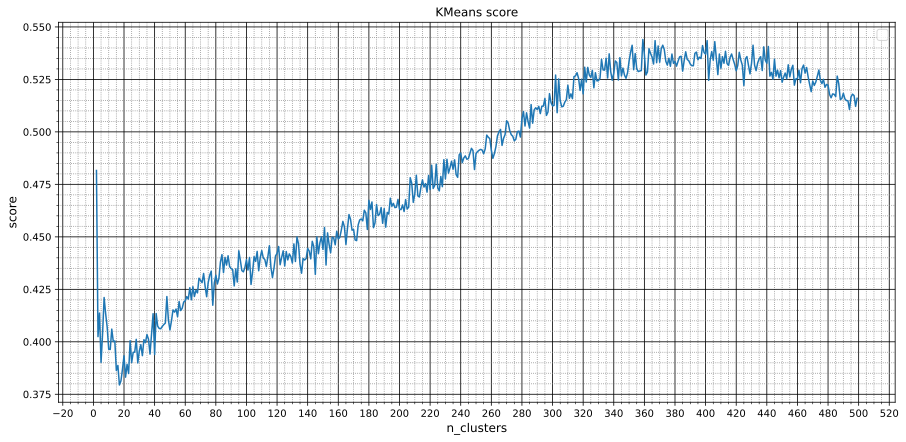

In [135]:
fig, ax = plt.subplots(figsize=(15,7)) 
plt.xlabel('n_clusters', fontsize=12)
plt.ylabel('score', fontsize=12)
plt.grid(True)
plt.grid(which='major', color = 'k')
plt.minorticks_on()
plt.grid(which='minor', color = 'gray', linestyle = ':')
ax.xaxis.set_major_locator(ticker.MultipleLocator(20))
#plt.tick_params(which='major', length=5, color='k', direction='in', top="on", right="on")
plt.plot(n_clusters, k_means_score)
plt.legend(fontsize = 14)
plt.title("KMeans score")

In [134]:
n_clusters = np.arange(2, 100)
k_means_score = []
for n in n_clusters:
    k_means = KMeans(n)
    km_pred = k_means.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
    k_means_score.append(silhouette_score(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']], km_pred))

No handles with labels found to put in legend.


Text(0.5, 1.0, 'KMeans score')

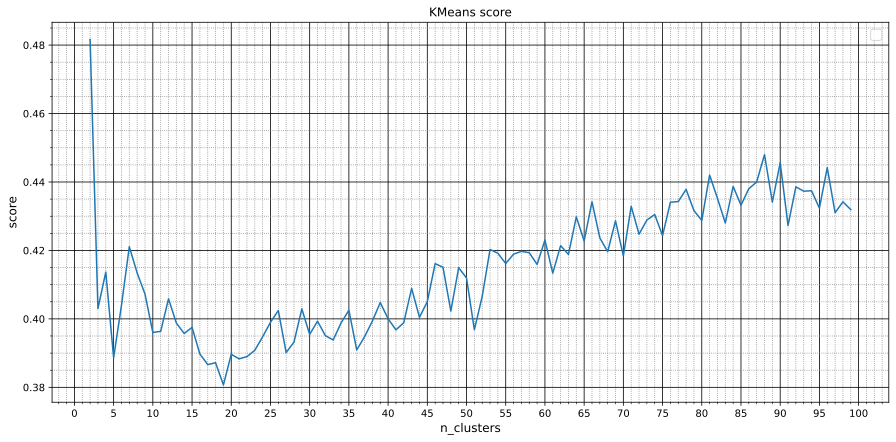

In [136]:
fig, ax = plt.subplots(figsize=(15,7)) 
plt.xlabel('n_clusters', fontsize=12)
plt.ylabel('score', fontsize=12)
plt.grid(True)
plt.grid(which='major', color = 'k')
plt.minorticks_on()
plt.grid(which='minor', color = 'gray', linestyle = ':')
ax.xaxis.set_major_locator(ticker.MultipleLocator(5))
#plt.tick_params(which='major', length=5, color='k', direction='in', top="on", right="on")
plt.plot(n_clusters, k_means_score)
plt.legend(fontsize = 14)
plt.title("KMeans score")

In [137]:
opt_cl = np.argmax(np.array(k_means_score[1: ])) + 2
opt_cl

87

In [138]:
kmeans = KMeans(n_clusters=opt_cl)
km_res = kmeans.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])

In [139]:
draw_clustered_map(data, km_res)

In [87]:
n_eps = np.linspace(0.0001, 1, num=1000, endpoint=True)
dbscan_score = []
for e in tqdm(n_eps):
    dbscan = DBSCAN(eps=e)
    dbscan_pred = dbscan.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
    if len(np.unique(dbscan_pred)) > 1:
        dbscan_score.append(silhouette_score(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']], dbscan_pred))
    else:
        dbscan_score.append(0)

100%|██████████| 1000/1000 [00:18<00:00, 53.85it/s]


No handles with labels found to put in legend.


Text(0.5, 1.0, 'DBSCAN score')

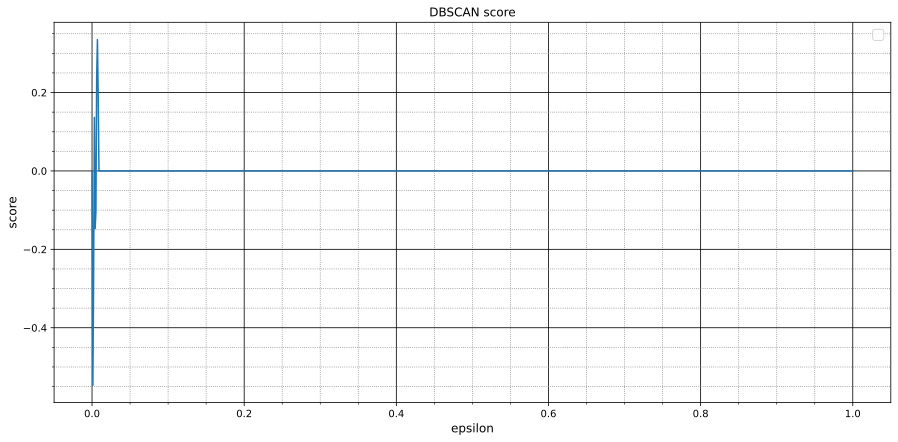

In [89]:
fig, ax = plt.subplots(figsize=(15,7)) 
plt.xlabel('epsilon', fontsize=12)
plt.ylabel('score', fontsize=12)
plt.grid(True)
plt.grid(which='major', color = 'k')
plt.minorticks_on()
plt.grid(which='minor', color = 'gray', linestyle = ':')
#ax.xaxis.set_major_locator(ticker.MultipleLocator(0))
#plt.tick_params(which='major', length=5, color='k', direction='in', top="on", right="on")
plt.plot(n_eps, dbscan_score)
plt.legend(fontsize = 14)
plt.title("DBSCAN score")

Видно, что большая часть перебранных значений нам не подходит (получается один класс). Поэтому рассмотрим значения параметра на меньшем промежутке.

In [142]:
n_eps = np.linspace(0.000001, 0.01, num=1000, endpoint=True)
dbscan_score = []
for e in tqdm(n_eps):
    dbscan = DBSCAN(eps=e)
    dbscan_pred = dbscan.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])
    if len(np.unique(dbscan_pred)) > 1:
        dbscan_score.append(silhouette_score(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']], dbscan_pred))
        if len(np.unique(dbscan_pred)) > 2:
            print(e)
    else:
        dbscan_score.append(0)

  6%|▌         | 60/1000 [00:02<00:56, 16.77it/s]

0.0005615045045045046
0.0005715135135135136
0.0005815225225225227
0.0005915315315315316


  6%|▋         | 64/1000 [00:02<01:00, 15.41it/s]

0.0006015405405405406
0.0006115495495495496
0.0006215585585585587
0.0006315675675675677


  7%|▋         | 68/1000 [00:03<01:00, 15.51it/s]

0.0006415765765765767
0.0006515855855855857
0.0006615945945945946
0.0006716036036036037


  7%|▋         | 72/1000 [00:03<00:59, 15.62it/s]

0.0006816126126126127
0.0006916216216216217
0.0007016306306306307
0.0007116396396396398


  8%|▊         | 76/1000 [00:03<00:57, 16.10it/s]

0.0007216486486486488
0.0007316576576576577
0.0007416666666666667
0.0007516756756756758


  8%|▊         | 80/1000 [00:03<00:57, 15.91it/s]

0.0007616846846846848
0.0007716936936936938
0.0007817027027027028
0.0007917117117117119


  8%|▊         | 84/1000 [00:04<00:55, 16.41it/s]

0.0008017207207207209
0.0008117297297297298
0.0008217387387387388
0.0008317477477477478


  9%|▉         | 88/1000 [00:04<00:53, 16.90it/s]

0.0008417567567567569
0.0008517657657657659
0.0008617747747747749
0.0008717837837837839


  9%|▉         | 90/1000 [00:04<00:53, 17.08it/s]

0.000881792792792793
0.0008918018018018019
0.0009018108108108109
0.0009118198198198199


  9%|▉         | 94/1000 [00:04<00:58, 15.60it/s]

0.000921828828828829
0.000931837837837838
0.000941846846846847


 10%|▉         | 98/1000 [00:04<00:58, 15.32it/s]

0.000951855855855856
0.0009618648648648649
0.000971873873873874
0.0009818828828828828


 10%|█         | 100/1000 [00:05<00:59, 15.05it/s]

0.0009918918918918919
0.001001900900900901


 10%|█         | 102/1000 [00:05<01:04, 13.82it/s]

0.0010119099099099099


 10%|█         | 104/1000 [00:05<01:05, 13.63it/s]

0.001021918918918919
0.001031927927927928
0.001041936936936937


 11%|█         | 106/1000 [00:05<01:04, 13.82it/s]

0.001051945945945946
0.001061954954954955


 11%|█         | 108/1000 [00:05<01:03, 13.96it/s]

0.001071963963963964
0.001081972972972973


 11%|█         | 110/1000 [00:05<01:06, 13.33it/s]

0.001091981981981982
0.001101990990990991


 11%|█         | 112/1000 [00:06<01:05, 13.47it/s]

0.0011120000000000001
0.001122009009009009


 11%|█▏        | 114/1000 [00:06<01:05, 13.47it/s]

0.0011320180180180181
0.001142027027027027
0.001152036036036036


 12%|█▏        | 116/1000 [00:06<01:03, 13.89it/s]

0.0011620450450450452


 12%|█▏        | 118/1000 [00:06<01:00, 14.49it/s]

0.001172054054054054
0.0011820630630630631


 12%|█▏        | 120/1000 [00:06<00:58, 15.00it/s]

0.001192072072072072
0.0012020810810810811


 12%|█▏        | 122/1000 [00:06<00:57, 15.21it/s]

0.0012120900900900902
0.001222099099099099

 12%|█▏        | 124/1000 [00:06<00:59, 14.75it/s]


0.0012321081081081082
0.0012421171171171173


 13%|█▎        | 126/1000 [00:06<00:58, 15.07it/s]

0.0012521261261261261


 13%|█▎        | 128/1000 [00:07<00:56, 15.34it/s]

0.0012621351351351352
0.0012721441441441441
0.0012821531531531532

 13%|█▎        | 130/1000 [00:07<00:56, 15.35it/s]


0.0012921621621621623


 13%|█▎        | 132/1000 [00:07<00:55, 15.71it/s]

0.0013021711711711712
0.0013121801801801803


 13%|█▎        | 134/1000 [00:07<00:53, 16.23it/s]

0.0013221891891891891
0.0013321981981981982


 14%|█▎        | 136/1000 [00:07<00:52, 16.53it/s]

0.0013422072072072073
0.0013522162162162162
0.0013622252252252253
0.0013722342342342344


 14%|█▍        | 138/1000 [00:07<00:53, 16.26it/s]

0.0013822432432432433
0.0013922522522522524


 14%|█▍        | 140/1000 [00:07<00:53, 16.16it/s]

0.0014022612612612612


 14%|█▍        | 142/1000 [00:07<00:54, 15.65it/s]

0.0014122702702702703
0.0014222792792792794
0.0014322882882882883


 14%|█▍        | 144/1000 [00:08<00:54, 15.79it/s]

0.0014422972972972974


 15%|█▍        | 148/1000 [00:08<00:55, 15.29it/s]

0.0014523063063063063
0.0014623153153153154
0.0014723243243243245


 15%|█▌        | 150/1000 [00:08<00:53, 15.76it/s]

0.0014823333333333333
0.0014923423423423424
0.0015023513513513515
0.0015123603603603604

 15%|█▌        | 154/1000 [00:08<00:58, 14.38it/s]


0.0015223693693693695
0.0015323783783783784


 16%|█▌        | 156/1000 [00:08<01:01, 13.66it/s]

0.0015423873873873875
0.0015523963963963966
0.0015624054054054054


 16%|█▌        | 160/1000 [00:09<01:04, 13.08it/s]

0.0015724144144144145
0.0015824234234234236
0.0015924324324324325


 16%|█▌        | 162/1000 [00:09<01:03, 13.21it/s]

0.0016024414414414416
0.0016124504504504505
0.0016224594594594596


 17%|█▋        | 166/1000 [00:09<01:04, 12.99it/s]

0.0016324684684684686
0.0016424774774774775
0.0016524864864864866


 17%|█▋        | 168/1000 [00:09<01:06, 12.45it/s]

0.0016624954954954955
0.0016725045045045046
0.0016825135135135137


 17%|█▋        | 172/1000 [00:10<01:05, 12.57it/s]

0.0016925225225225226
0.0017025315315315316
0.0017125405405405407


 17%|█▋        | 174/1000 [00:10<01:04, 12.88it/s]

0.0017225495495495496
0.0017325585585585587
0.0017425675675675676
0.0017525765765765767


 18%|█▊        | 178/1000 [00:10<00:56, 14.51it/s]

0.0017625855855855858
0.0017725945945945946
0.0017826036036036037


 18%|█▊        | 182/1000 [00:10<00:49, 16.57it/s]

0.0017926126126126126
0.0018026216216216217
0.0018126306306306308
0.0018226396396396397


 19%|█▊        | 186/1000 [00:11<00:51, 15.88it/s]

0.0018326486486486488
0.0018426576576576579
0.0018526666666666667


 19%|█▉        | 188/1000 [00:11<00:53, 15.23it/s]

0.0018626756756756758
0.0018726846846846847
0.0018826936936936938
0.001892702702702703


 19%|█▉        | 192/1000 [00:11<00:52, 15.51it/s]

0.0019027117117117118
0.0019127207207207209
0.0019227297297297297
0.0019327387387387388

 20%|█▉        | 196/1000 [00:11<00:53, 14.99it/s]


0.001942747747747748
0.0019527567567567568
0.001962765765765766


 20%|██        | 200/1000 [00:11<00:50, 15.98it/s]

0.001972774774774775
0.001982783783783784
0.001992792792792793
0.0020028018018018023

 20%|██        | 204/1000 [00:12<00:49, 16.07it/s]


0.002012810810810811
0.00202281981981982
0.0020328288288288293


 21%|██        | 208/1000 [00:12<00:45, 17.34it/s]

0.002042837837837838
0.002052846846846847
0.0020628558558558564
0.0020728648648648653


 21%|██        | 212/1000 [00:12<00:45, 17.46it/s]

0.002082873873873874
0.002092882882882883
0.0021028918918918923
0.002112900900900901


 22%|██▏       | 216/1000 [00:12<00:43, 17.85it/s]

0.00212290990990991
0.0021329189189189194
0.0021429279279279283
0.002152936936936937


 22%|██▏       | 220/1000 [00:13<00:43, 17.88it/s]

0.0021629459459459465
0.0021729549549549553
0.002182963963963964
0.0021929729729729735


 22%|██▏       | 224/1000 [00:13<00:45, 17.09it/s]

0.0022029819819819824
0.0022129909909909913
0.0022230000000000006
0.0022330090090090095


 23%|██▎       | 228/1000 [00:13<00:44, 17.32it/s]

0.0022430180180180183
0.002253027027027027
0.0022630360360360365
0.0022730450450450454


 23%|██▎       | 230/1000 [00:13<00:45, 16.95it/s]

0.0022830540540540543
0.0022930630630630636
0.0023030720720720725
0.0023130810810810813

 23%|██▎       | 234/1000 [00:13<00:48, 15.77it/s]


0.0023230900900900906
0.0023330990990990995
0.0023431081081081084


 24%|██▍       | 238/1000 [00:14<00:49, 15.37it/s]

0.0023531171171171177
0.0023631261261261266
0.0023731351351351355
0.0023831441441441443


 24%|██▍       | 242/1000 [00:14<00:46, 16.17it/s]

0.0023931531531531536
0.0024031621621621625
0.0024131711711711714
0.0024231801801801807


 25%|██▍       | 246/1000 [00:14<00:46, 16.09it/s]

0.0024331891891891896
0.0024431981981981985
0.0024532072072072078
0.0024632162162162166


 25%|██▌       | 250/1000 [00:14<00:45, 16.31it/s]

0.0024732252252252255
0.002483234234234235
0.0024932432432432437
0.0025032522522522526


 25%|██▌       | 254/1000 [00:15<00:44, 16.65it/s]

0.0025132612612612615
0.0025232702702702708
0.0025332792792792796
0.0025432882882882885


 26%|██▌       | 258/1000 [00:15<00:45, 16.48it/s]

0.002553297297297298
0.0025633063063063067
0.0025733153153153156
0.002583324324324325


 26%|██▌       | 262/1000 [00:15<00:43, 16.82it/s]

0.0025933333333333338
0.0026033423423423427
0.002613351351351352
0.002623360360360361


 27%|██▋       | 266/1000 [00:15<00:41, 17.78it/s]

0.0026333693693693697
0.0026433783783783786
0.002653387387387388
0.0026633963963963968


 27%|██▋       | 270/1000 [00:16<00:44, 16.49it/s]

0.0026734054054054057
0.002683414414414415
0.002693423423423424
0.0027034324324324327


 27%|██▋       | 274/1000 [00:16<00:43, 16.60it/s]

0.002713441441441442
0.002723450450450451
0.0027334594594594598
0.002743468468468469


 28%|██▊       | 278/1000 [00:16<00:42, 16.99it/s]

0.002753477477477478
0.002763486486486487
0.0027734954954954957
0.002783504504504505

 28%|██▊       | 282/1000 [00:16<00:42, 16.74it/s]


0.002793513513513514
0.0028035225225225228
0.002813531531531532


 29%|██▊       | 286/1000 [00:17<00:43, 16.54it/s]

0.002823540540540541
0.00283354954954955
0.002843558558558559
0.002853567567567568


 29%|██▉       | 290/1000 [00:17<00:41, 17.06it/s]

0.002863576576576577
0.002873585585585586
0.002883594594594595
0.002893603603603604


 29%|██▉       | 294/1000 [00:17<00:40, 17.29it/s]

0.002903612612612613
0.002913621621621622
0.002923630630630631
0.00293363963963964


 30%|██▉       | 298/1000 [00:17<00:39, 17.82it/s]

0.002943648648648649
0.002953657657657658
0.002963666666666667
0.0029736756756756763


 30%|███       | 302/1000 [00:18<00:39, 17.63it/s]

0.002983684684684685
0.002993693693693694
0.0030037027027027033
0.003013711711711712


 31%|███       | 306/1000 [00:18<00:40, 17.07it/s]

0.003023720720720721
0.0030337297297297304
0.0030437387387387393
0.003053747747747748


 31%|███       | 310/1000 [00:18<00:40, 17.07it/s]

0.003063756756756757
0.0030737657657657663
0.003083774774774775
0.003093783783783784


 31%|███       | 312/1000 [00:18<00:40, 16.93it/s]

0.0031037927927927934
0.0031138018018018023
0.003123810810810811
0.0031338198198198205

 32%|███▏      | 316/1000 [00:18<00:39, 17.11it/s]


0.0031438288288288293
0.0031538378378378382
0.0031638468468468475


 32%|███▏      | 320/1000 [00:19<00:40, 16.94it/s]

0.0031738558558558564
0.0031838648648648653
0.003193873873873874
0.0032038828828828835


 32%|███▏      | 324/1000 [00:19<00:45, 14.89it/s]

0.0032138918918918923
0.0032239009009009012
0.0032339099099099105


 33%|███▎      | 326/1000 [00:19<00:45, 14.98it/s]

0.0032439189189189194
0.0032539279279279283
0.0032639369369369376


 33%|███▎      | 330/1000 [00:19<00:43, 15.30it/s]

0.0032739459459459465
0.0032839549549549553
0.0032939639639639647
0.0033039729729729735

 33%|███▎      | 332/1000 [00:19<00:45, 14.70it/s]


0.0033139819819819824
0.0033239909909909913


 34%|███▎      | 336/1000 [00:20<00:43, 15.17it/s]

0.0033340000000000006
0.0033440090090090095
0.0033540180180180183
0.0033640270270270277


 34%|███▍      | 340/1000 [00:20<00:44, 14.80it/s]

0.0033740360360360365
0.0033840450450450454
0.0033940540540540547


 34%|███▍      | 344/1000 [00:20<00:42, 15.46it/s]

0.0034040630630630636
0.0034140720720720725
0.0034240810810810818
0.0034340900900900907


 35%|███▍      | 346/1000 [00:20<00:40, 15.99it/s]

0.0034440990990990995
0.0034541081081081084
0.0034641171171171177


 35%|███▌      | 350/1000 [00:21<00:43, 14.94it/s]

0.0034741261261261266
0.0034841351351351355
0.0034941441441441448
0.0035041531531531537

 35%|███▌      | 352/1000 [00:21<00:43, 14.87it/s]


0.0035141621621621625
0.003524171171171172
0.0035341801801801807


 36%|███▌      | 358/1000 [00:21<00:42, 15.16it/s]

0.0035441891891891896
0.003554198198198199
0.0035642072072072078
0.0035742162162162167


 36%|███▌      | 362/1000 [00:21<00:42, 15.13it/s]

0.0035842252252252255
0.003594234234234235
0.0036042432432432437
0.0036142522522522526


 37%|███▋      | 366/1000 [00:22<00:41, 15.30it/s]

0.003624261261261262
0.0036342702702702708
0.0036442792792792797
0.003654288288288289


 37%|███▋      | 370/1000 [00:22<00:39, 16.04it/s]

0.003664297297297298
0.0036743063063063067
0.003684315315315316
0.003694324324324325


 37%|███▋      | 372/1000 [00:22<00:39, 15.91it/s]

0.0037043333333333338
0.0037143423423423427
0.003724351351351352
0.003734360360360361


 38%|███▊      | 376/1000 [00:22<00:40, 15.43it/s]

0.0037443693693693697
0.003754378378378379
0.003764387387387388


 38%|███▊      | 380/1000 [00:23<00:38, 16.04it/s]

0.003774396396396397
0.003784405405405406
0.003794414414414415
0.003804423423423424


 38%|███▊      | 384/1000 [00:23<00:38, 15.91it/s]

0.003814432432432433
0.003824441441441442
0.003834450450450451
0.00384445945945946


 39%|███▉      | 388/1000 [00:23<00:38, 15.90it/s]

0.003854468468468469
0.003864477477477478
0.003874486486486487
0.003884495495495496

 39%|███▉      | 392/1000 [00:23<00:35, 16.96it/s]


0.003894504504504505
0.003904513513513514
0.003914522522522523


 40%|███▉      | 396/1000 [00:23<00:36, 16.72it/s]

0.003924531531531532
0.003934540540540541
0.00394454954954955
0.003954558558558559


 40%|████      | 400/1000 [00:24<00:35, 16.69it/s]

0.003964567567567568
0.003974576576576577
0.003984585585585586
0.0039945945945945955


 40%|████      | 404/1000 [00:24<00:34, 17.19it/s]

0.004004603603603604
0.004014612612612613
0.004024621621621622
0.004034630630630631


 41%|████      | 408/1000 [00:24<00:34, 17.29it/s]

0.00404463963963964
0.004054648648648649
0.0040646576576576585
0.004074666666666667


 41%|████      | 412/1000 [00:24<00:33, 17.52it/s]

0.004084675675675676
0.004094684684684685
0.004104693693693694
0.004114702702702703


 42%|████▏     | 416/1000 [00:25<00:34, 17.13it/s]

0.004124711711711713
0.0041347207207207215
0.00414472972972973
0.004154738738738739


 42%|████▏     | 420/1000 [00:25<00:33, 17.54it/s]

0.004164747747747748
0.004174756756756757
0.004184765765765766
0.004194774774774776


 42%|████▏     | 424/1000 [00:25<00:33, 17.13it/s]

0.0042047837837837845
0.004214792792792793
0.004224801801801802
0.004234810810810811


 43%|████▎     | 428/1000 [00:25<00:32, 17.36it/s]

0.00424481981981982
0.00425482882882883
0.004264837837837839
0.0042748468468468475


 43%|████▎     | 432/1000 [00:26<00:33, 17.14it/s]

0.004284855855855856
0.004294864864864865
0.004304873873873874
0.004314882882882884


 44%|████▎     | 436/1000 [00:26<00:33, 17.05it/s]

0.004324891891891893
0.004334900900900902
0.0043449099099099105
0.004354918918918919


 44%|████▍     | 438/1000 [00:26<00:32, 17.22it/s]

0.004364927927927928
0.004374936936936937
0.004384945945945947


 44%|████▍     | 442/1000 [00:26<00:37, 14.76it/s]

0.004394954954954956
0.004404963963963965
0.0044149729729729735


 45%|████▍     | 446/1000 [00:26<00:34, 16.09it/s]

0.004424981981981982
0.004434990990990991
0.004445000000000001
0.00445500900900901


 45%|████▍     | 448/1000 [00:27<00:32, 16.75it/s]

0.004465018018018019
0.004475027027027028
0.0044850360360360365
0.004495045045045045


 45%|████▌     | 452/1000 [00:27<00:34, 15.95it/s]

0.004505054054054054
0.004515063063063064
0.004525072072072073
0.004535081081081082


 46%|████▌     | 458/1000 [00:27<00:33, 16.18it/s]

0.004545090090090091
0.0045550990990990995
0.004565108108108108
0.004575117117117118


 46%|████▌     | 462/1000 [00:27<00:33, 16.23it/s]

0.004585126126126127
0.004595135135135136
0.004605144144144145
0.004615153153153154


 47%|████▋     | 466/1000 [00:28<00:33, 16.13it/s]

0.0046251621621621625
0.004635171171171171
0.004645180180180181
0.00465518918918919


 47%|████▋     | 468/1000 [00:28<00:33, 16.06it/s]

0.004665198198198199
0.004675207207207208
0.004685216216216217
0.0046952252252252255


 47%|████▋     | 474/1000 [00:28<00:33, 15.79it/s]

0.004705234234234235
0.004715243243243244
0.004725252252252253
0.004735261261261262


 48%|████▊     | 478/1000 [00:28<00:32, 16.00it/s]

0.004745270270270271
0.00475527927927928
0.0047652882882882885
0.004775297297297298


 48%|████▊     | 482/1000 [00:29<00:32, 15.91it/s]

0.004785306306306307
0.004795315315315316
0.004805324324324325
0.004815333333333334


 48%|████▊     | 484/1000 [00:29<00:32, 15.81it/s]

0.004825342342342343
0.004835351351351352
0.004845360360360361
0.00485536936936937


 49%|████▉     | 490/1000 [00:29<00:32, 15.76it/s]

0.004865378378378379
0.004875387387387388
0.004885396396396397
0.004895405405405406


 49%|████▉     | 492/1000 [00:29<00:32, 15.69it/s]

0.004905414414414415
0.004915423423423424
0.004925432432432433
0.004935441441441442


 50%|████▉     | 496/1000 [00:30<00:32, 15.41it/s]

0.004945450450450451
0.00495545945945946
0.0049654684684684695


 50%|█████     | 500/1000 [00:30<00:32, 15.34it/s]

0.004975477477477478
0.004985486486486487
0.004995495495495496
0.005005504504504505


 50%|█████     | 504/1000 [00:30<00:31, 15.79it/s]

0.005015513513513514
0.005025522522522523
0.0050355315315315325
0.005045540540540541


 51%|█████     | 508/1000 [00:30<00:31, 15.76it/s]

0.00505554954954955
0.005065558558558559
0.005075567567567568
0.005085576576576577


 51%|█████     | 512/1000 [00:31<00:32, 14.90it/s]

0.005095585585585587
0.0051055945945945955
0.005115603603603604


 52%|█████▏    | 516/1000 [00:31<00:33, 14.34it/s]

0.005125612612612613
0.005135621621621622
0.005145630630630631
0.00515563963963964


 52%|█████▏    | 520/1000 [00:31<00:32, 14.60it/s]

0.00516564864864865
0.0051756576576576585
0.005185666666666667
0.005195675675675676


 52%|█████▏    | 522/1000 [00:31<00:32, 14.86it/s]

0.005205684684684685
0.005215693693693694
0.005225702702702704
0.005235711711711713

 53%|█████▎    | 526/1000 [00:32<00:32, 14.37it/s]


0.0052457207207207215
0.00525572972972973


 53%|█████▎    | 528/1000 [00:32<00:34, 13.79it/s]

0.005265738738738739
0.005275747747747748
0.005285756756756757


 53%|█████▎    | 532/1000 [00:32<00:33, 13.91it/s]

0.005295765765765767
0.005305774774774776
0.0053157837837837845


 53%|█████▎    | 534/1000 [00:32<00:33, 13.76it/s]

0.005325792792792793
0.005335801801801802
0.005345810810810811
0.005355819819819821


 54%|█████▍    | 540/1000 [00:33<00:31, 14.44it/s]

0.00536582882882883
0.005375837837837839
0.0053858468468468475
0.005395855855855856


 54%|█████▍    | 542/1000 [00:33<00:30, 14.80it/s]

0.005405864864864865
0.005415873873873874
0.005425882882882884
0.005435891891891893


 55%|█████▍    | 546/1000 [00:33<00:31, 14.29it/s]

0.005445900900900902
0.0054559099099099105
0.005465918918918919
0.005475927927927928


 55%|█████▌    | 552/1000 [00:33<00:30, 14.68it/s]

0.005485936936936938
0.005495945945945947
0.005505954954954956
0.005515963963963965


 55%|█████▌    | 554/1000 [00:34<00:31, 14.34it/s]

0.0055259729729729735
0.005535981981981982
0.005545990990990991
0.005556000000000001

 56%|█████▌    | 558/1000 [00:34<00:31, 14.16it/s]


0.00556600900900901
0.005576018018018019


 56%|█████▌    | 560/1000 [00:34<00:30, 14.45it/s]

0.005586027027027028
0.0055960360360360365
0.005606045045045045
0.005616054054054055


 57%|█████▋    | 566/1000 [00:34<00:30, 14.42it/s]

0.005626063063063064
0.005636072072072073
0.005646081081081082
0.005656090090090091


 57%|█████▋    | 570/1000 [00:35<00:30, 14.26it/s]

0.0056660990990990995
0.005676108108108108
0.005686117117117118
0.005696126126126127


 57%|█████▋    | 572/1000 [00:35<00:30, 14.22it/s]

0.005706135135135136
0.005716144144144145
0.005726153153153154
0.0057361621621621625

 58%|█████▊    | 576/1000 [00:35<00:28, 14.69it/s]


0.005746171171171172
0.005756180180180181
0.00576618918918919


 58%|█████▊    | 580/1000 [00:35<00:28, 14.80it/s]

0.005776198198198199
0.005786207207207208
0.005796216216216217
0.0058062252252252256


 58%|█████▊    | 584/1000 [00:36<00:26, 15.71it/s]

0.005816234234234235
0.005826243243243244
0.005836252252252253
0.005846261261261262


 59%|█████▉    | 588/1000 [00:36<00:26, 15.40it/s]

0.005856270270270271
0.00586627927927928
0.005876288288288289


 59%|█████▉    | 592/1000 [00:36<00:25, 15.75it/s]

0.005886297297297298
0.005896306306306307
0.005906315315315316
0.005916324324324325


 60%|█████▉    | 596/1000 [00:36<00:24, 16.62it/s]

0.005926333333333334
0.005936342342342343
0.005946351351351352
0.005956360360360361


 60%|██████    | 600/1000 [00:37<00:22, 17.47it/s]

0.00596636936936937
0.005976378378378379
0.005986387387387388
0.005996396396396397


 60%|██████    | 604/1000 [00:37<00:21, 18.20it/s]

0.0060064054054054065
0.006016414414414415
0.006026423423423424
0.006036432432432433


100%|██████████| 1000/1000 [00:51<00:00, 19.46it/s]


No handles with labels found to put in legend.


Text(0.5, 1.0, 'DBSCAN score')

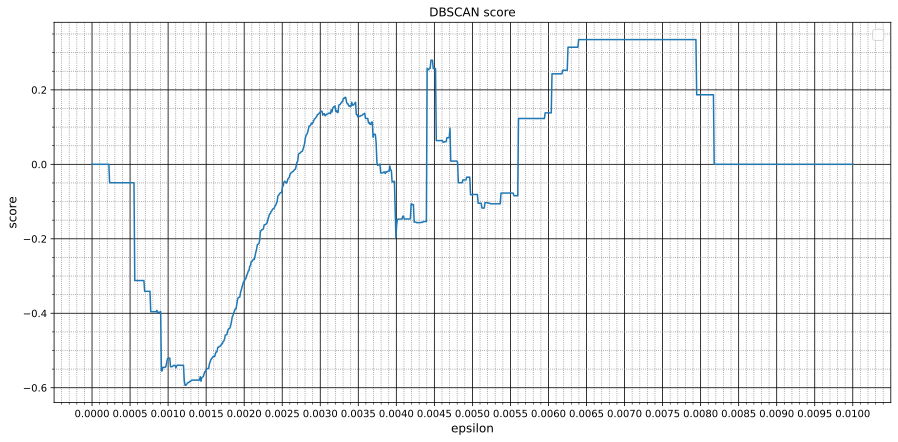

In [143]:
fig, ax = plt.subplots(figsize=(15,7)) 
plt.xlabel('epsilon', fontsize=12)
plt.ylabel('score', fontsize=12)
plt.grid(True)
plt.grid(which='major', color = 'k')
plt.minorticks_on()
plt.grid(which='minor', color = 'gray', linestyle = ':')
ax.xaxis.set_major_locator(ticker.MultipleLocator(0.0005))
#plt.tick_params(which='major', length=5, color='k', direction='in', top="on", right="on")
plt.plot(n_eps, dbscan_score)
plt.legend(fontsize = 14)
plt.title("DBSCAN score")

In [92]:
opt_eps = n_eps[np.argmax(np.array(dbscan_score))]
opt_eps

0.0064

In [98]:
np.max(np.array(dbscan_score))

0.335052715446048

In [99]:
np.argmax(np.array(dbscan_score))

63

In [147]:
dbscan = DBSCAN(eps=0.004475027027027028)
db_res = dbscan.fit_predict(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']])

In [97]:
db_res

array([0, 0, 0, ..., 0, 0, 0], dtype=int64)

In [148]:
np.unique(db_res)

array([-1,  0,  1,  2,  3,  4,  5,  6,  7], dtype=int64)

In [149]:
draw_clustered_map(data, db_res)

In [107]:
n_clusters = np.arange(2, 500)
graph_clust_score = []
for n in tqdm(n_clusters):
    gc = GraphClustering(n_clusters=n)
    gc_pred = gc.fit_predict(adjacency_matrix)
    graph_clust_score.append(silhouette_score(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']], gc_pred))

100%|██████████| 498/498 [45:15<00:00,  5.45s/it]


No handles with labels found to put in legend.


Text(0.5, 1.0, 'GraphClustering score')

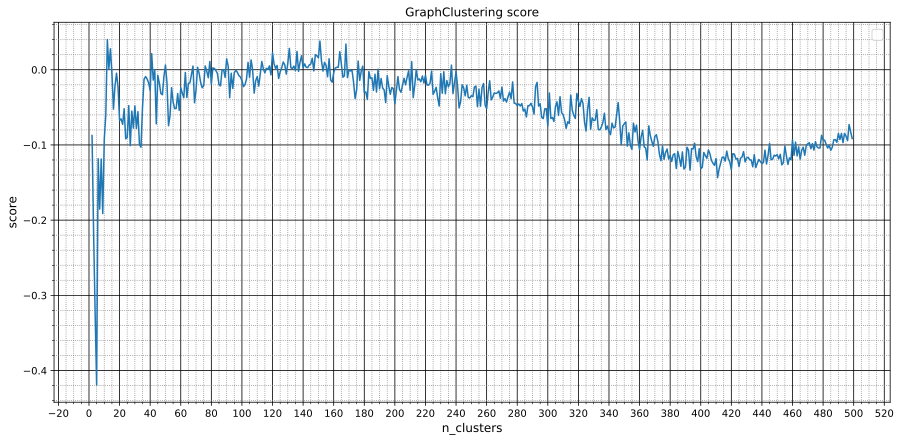

In [110]:
fig, ax = plt.subplots(figsize=(15,7)) 
plt.xlabel('n_clusters', fontsize=12)
plt.ylabel('score', fontsize=12)
plt.grid(True)
plt.grid(which='major', color = 'k')
plt.minorticks_on()
plt.grid(which='minor', color = 'gray', linestyle = ':')
ax.xaxis.set_major_locator(ticker.MultipleLocator(20))
#plt.tick_params(which='major', length=5, color='k', direction='in', top="on", right="on")
plt.plot(n_clusters, graph_clust_score)
plt.legend(fontsize = 14)
plt.title("GraphClustering score")

In [111]:
opt_cl = np.argmax(np.array(graph_clust_score)) + 2
opt_cl

12

In [113]:
np.max(np.array(graph_clust_score))

0.04012336634407821

In [114]:
n_comp = np.arange(2, 200)
graph_clust_score1 = []
for n in tqdm(n_comp):
    gc = GraphClustering(n_clusters=12, n_components=n)
    gc_pred = gc.fit_predict(adjacency_matrix)
    graph_clust_score1.append(silhouette_score(data[['Latitude_WGS84_en', 'Longitude_WGS84_en']], gc_pred))

100%|██████████| 198/198 [05:10<00:00,  1.57s/it]


No handles with labels found to put in legend.


Text(0.5, 1.0, 'GraphClustering score')

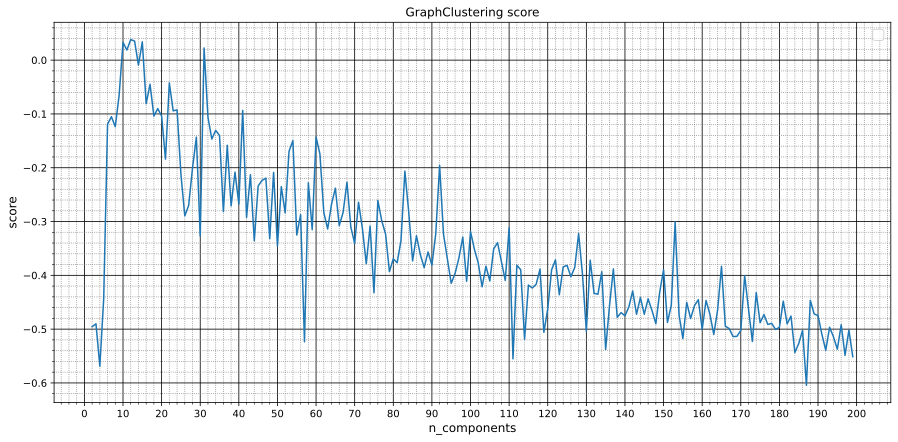

In [117]:
fig, ax = plt.subplots(figsize=(15,7)) 
plt.xlabel('n_components', fontsize=12)
plt.ylabel('score', fontsize=12)
plt.grid(True)
plt.grid(which='major', color = 'k')
plt.minorticks_on()
plt.grid(which='minor', color = 'gray', linestyle = ':')
ax.xaxis.set_major_locator(ticker.MultipleLocator(10))
#plt.tick_params(which='major', length=5, color='k', direction='in', top="on", right="on")
plt.plot(n_comp, graph_clust_score1)
plt.legend(fontsize = 14)
plt.title("GraphClustering score")

In [118]:
opt_comp = np.argmax(np.array(graph_clust_score1)) + 2
opt_comp

12

In [124]:
np.max(np.array(graph_clust_score1))

0.03816934676995756

In [125]:
np.max(np.array(graph_clust_score))

0.04012336634407821

In [126]:
graph_clust = GraphClustering(n_clusters=12, n_components=None)
gc_res = graph_clust.fit_predict(adjacency_matrix)

In [127]:
draw_clustered_map(data, gc_res)

**Ваш ответ здесь:** с использованием метрики siholuette_score получилось, что наилучшие результаты (в теории) достигаются при очень большом числе классов (почти 400) в KMeans, при 8 классах в DBSCAN и 12 классами в спектральной кластеризации. При этом с визуальной точки зрения 400 классов - слишком большое число, в каждом классе получается примерно 2-3 объекта. Поэтому для практического применения было выбрано 87 классов. С точки зрения структуры классов можно заметить, что KMeans выделяет шарообразные кластеры, DBSCAN умеет выделять шумовые объекты, а кластеры в спектральной классификации могут "проходить сквозь друг друга". \
С точки зрения применимости к данной задаче можно заметить, что алгоритм KMeans для нее слишком прост, алгоритм DBSCAN слишком сложен. Также из минусов DBSCAN можно отметить, что он отказывается от классификации некоторых точек, выделяя их в шумовые. Плюсом KMeans является скорость работы, DBSCAN - выделение объектов сложносй структуры (хотя в данном случае это скорее минус, чем плюс). В качестве плюса спектральной кластеризации можно отметить тот факт, что оптимальное число кластеров невелико, к тому же не самой простой структуры, а в качестве минуса - довольно долгое время обучения.\
Для данной задаче лучше всего подходит спектральная кластеризация, потому что она выделяет данные такой структуры, которая и подразумевается в задаче (маршруты)

-----

## Часть 2. Тематическое моделирование текстов

В этой части мы познакомимся с одной из самых популярных задач обучения без учителя &mdash; с задачей тематического моделирования текстов. Допустим, нам доступна некоторая коллекция документов без разметки, и мы хотим автоматически выделить несколько тем, которые встречаются в документах, а также присвоить каждому документу одну (или несколько) тем. Фактически, мы будем решать задачу, похожую на кластеризацию текстов: отличие в том, что нас будет интересовать не только разбиение текстов на группы, но и выделение ключевых слов, определяющих каждую тему.

Мы будем работать с новостными статьями BBC за 2004-2005 годы. Скачайте данные по [ссылке](https://www.kaggle.com/hgultekin/bbcnewsarchive).

In [4]:
data = pd.read_csv('bbc-news-data.csv', sep='\t')
data.sample(5)

,category,filename,title,content
1289,politics,394.txt,Economy focus for election battle,Britain's economic future will be at the hear...
1872,tech,049.txt,Domain system scam fear,A system to make it easier to create website ...
1044,politics,149.txt,Blair returns from peace mission,Prime Minister Tony Blair has arrived back fr...
654,entertainment,145.txt,Sir Paul rocks Super Bowl crowds,Sir Paul McCartney wowed fans with a live min...
134,business,135.txt,Feta cheese battle reaches court,A row over whether only Greece should be allo...


Как вы могли заметить, данные уже содержат разметку по тематике (колонка category). В этой части мы забудем, что она есть🙈, и будем работать только с текстовыми данными. Проведем предобработку текста, состоящую из следующих пунктов:

* Объединим заголовок и содержание статьи в одно поле.
* Приведем текст к нижнему регистру, разобьем его на токены.
* Оставим только буквенные слова (удалив, таким образом, пунктуацию и числа).
* Применим лемматизацию.
* Удалим стоп-слова.


In [5]:
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
from nltk.stem import WordNetLemmatizer

In [6]:
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('stopwords')

stop_words = set(stopwords.words('english') + ['ha', 'wa', 'say', 'said'])
lemmatizer = WordNetLemmatizer()

[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\Diana\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\Diana\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\Diana\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!


In [7]:
def preprocess(text):
    text = list(filter(str.isalpha, word_tokenize(text.lower())))
    text = list(lemmatizer.lemmatize(word) for word in text)
    text = list(word for word in text if word not in stop_words)
    return ' '.join(text)

In [8]:
data['raw_text'] = data.apply(lambda row: row.title + row.content, axis=1)
data['text'] = data.apply(lambda row: preprocess(row.raw_text), axis=1)

Для визуализации частот слов в текстах мы будем использовать [облака тегов](https://en.wikipedia.org/wiki/Tag_cloud).

In [11]:
from wordcloud import WordCloud

def draw_wordcloud(texts, max_words=1000, width=1000, height=500):
    wordcloud = WordCloud(background_color='white', max_words=max_words,
                          width=width, height=height)
    
    joint_texts = ' '.join(list(texts))
    wordcloud.generate(joint_texts)
    return wordcloud.to_image()

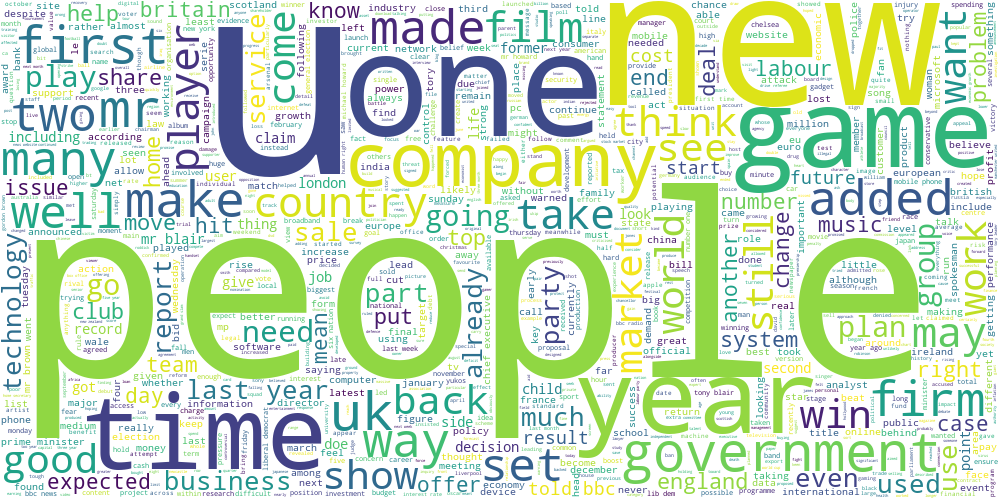

In [38]:
draw_wordcloud(data.text)

-----

**Задание 2.1 (1 балл).** 

* **(0.5 балла)** Обучите алгоритм K-Means на tf-idf представлениях текстов. 
* **(0.25 балла)** Постройте облака тегов для текстов из разных кластеров.
* **(0.25 балла)** (?) Получились ли темы интерпретируемыми? (?) Попробуйте озаглавить каждую тему.

**Подсказки:**
* Можно использовать готовую реализацию tf-idf векторайзера из sklearn
* При обучении tf-idf векторайзера рекомендуется отбрасывать редко встречающиеся слова.
* Воздержитесь от использования N-грамм при обучении tf-idf.
* Возьмите не очень большое число кластеров, чтобы было удобно интерпретировать получившиеся темы (например, `n_clusters` = 8).

**Ключевые слова:**
* *TfidfVectorizer*

In [9]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
vectorizer = TfidfVectorizer(min_df=50)
texts = vectorizer.fit_transform(data.text)

In [23]:
kmeans = KMeans()
kmeans_pred = kmeans.fit_predict(texts)

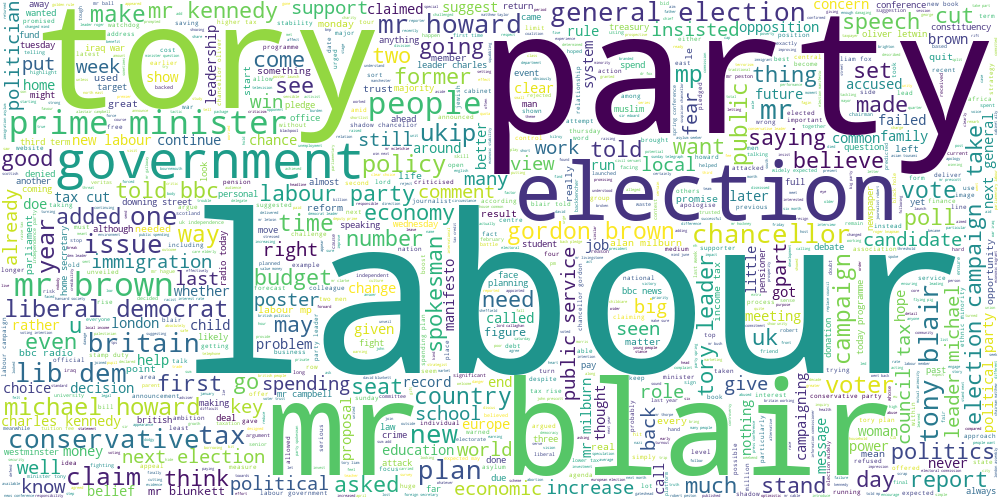

In [24]:
draw_wordcloud(data['text'][kmeans_pred == 0])

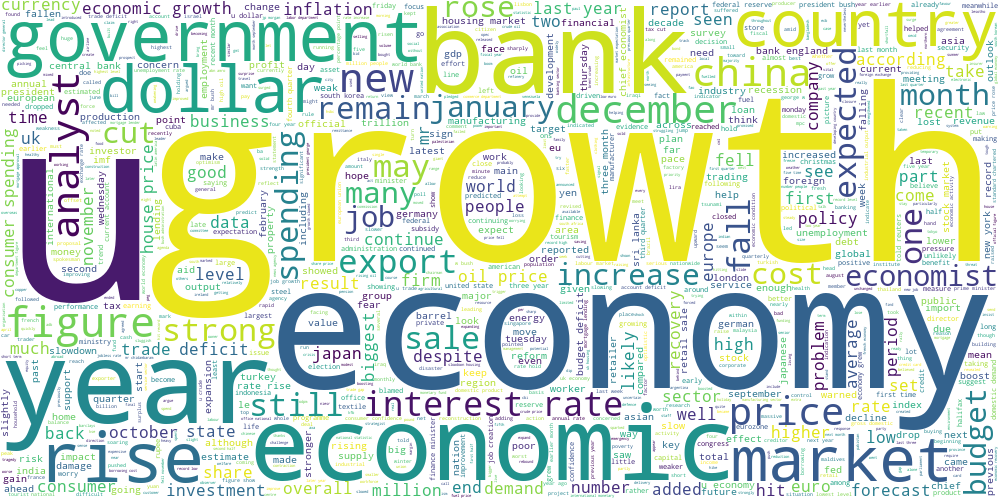

In [25]:
draw_wordcloud(data['text'][kmeans_pred == 1])

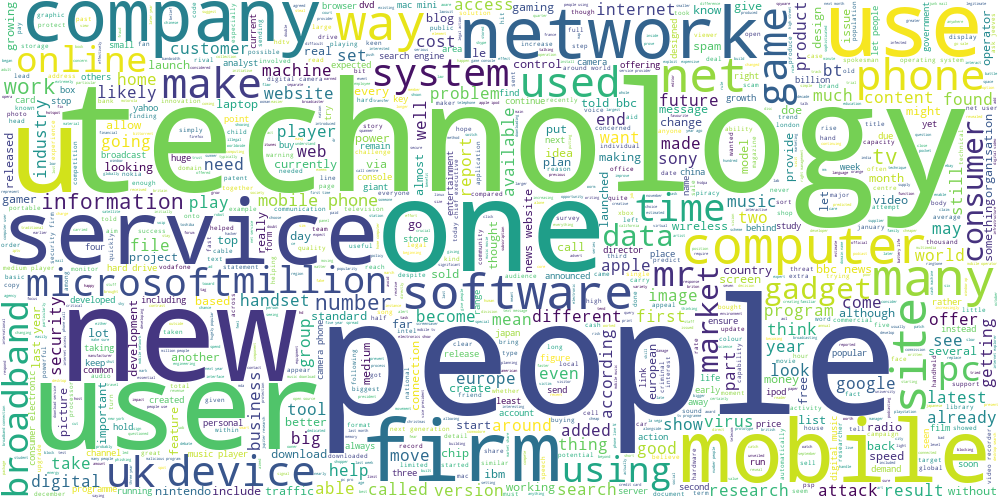

In [26]:
draw_wordcloud(data['text'][kmeans_pred == 2])

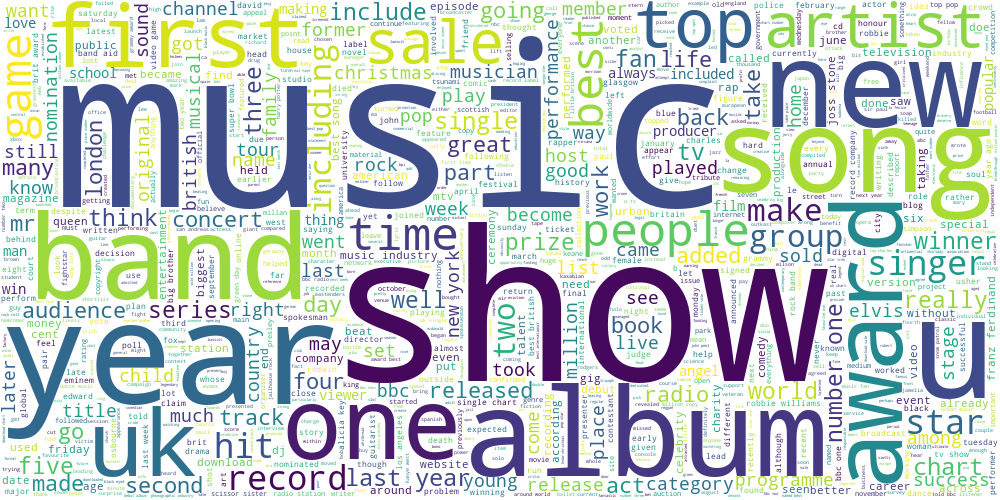

In [27]:
draw_wordcloud(data['text'][kmeans_pred == 3])

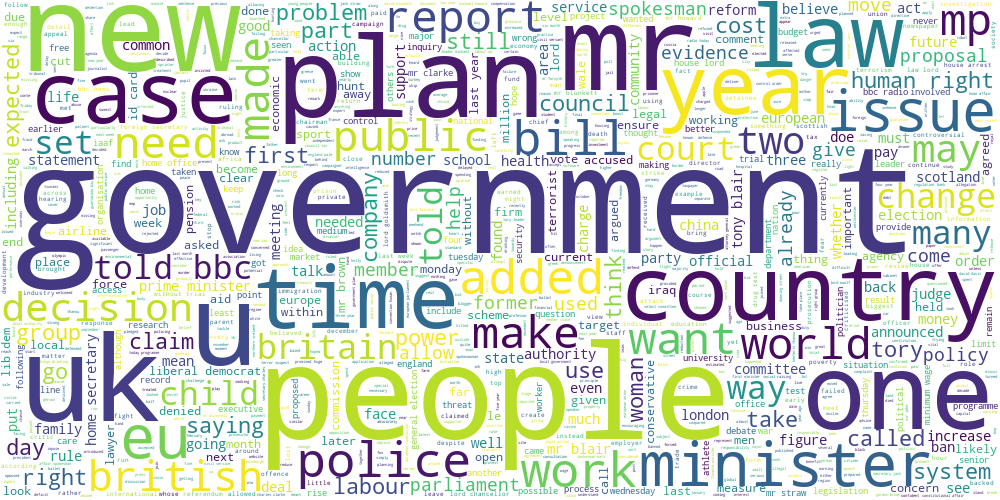

In [28]:
draw_wordcloud(data['text'][kmeans_pred == 4])

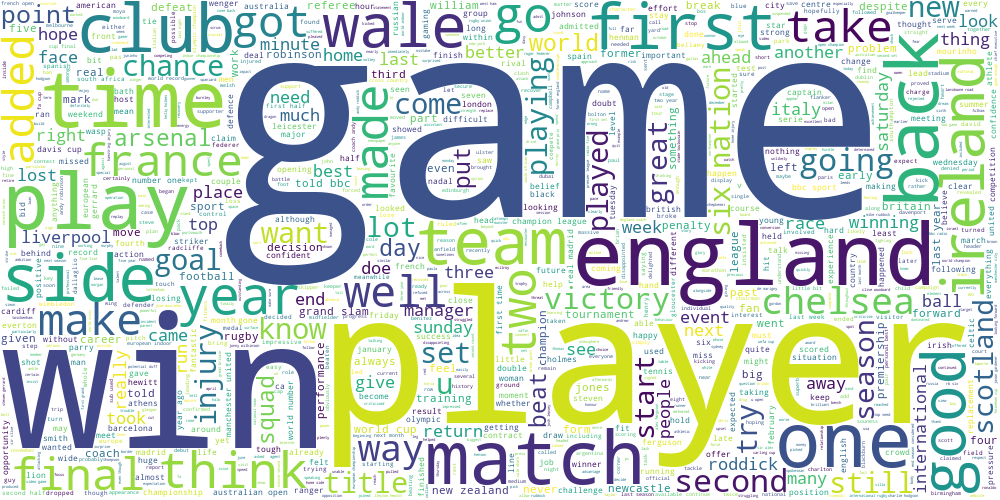

In [29]:
draw_wordcloud(data['text'][kmeans_pred == 5])

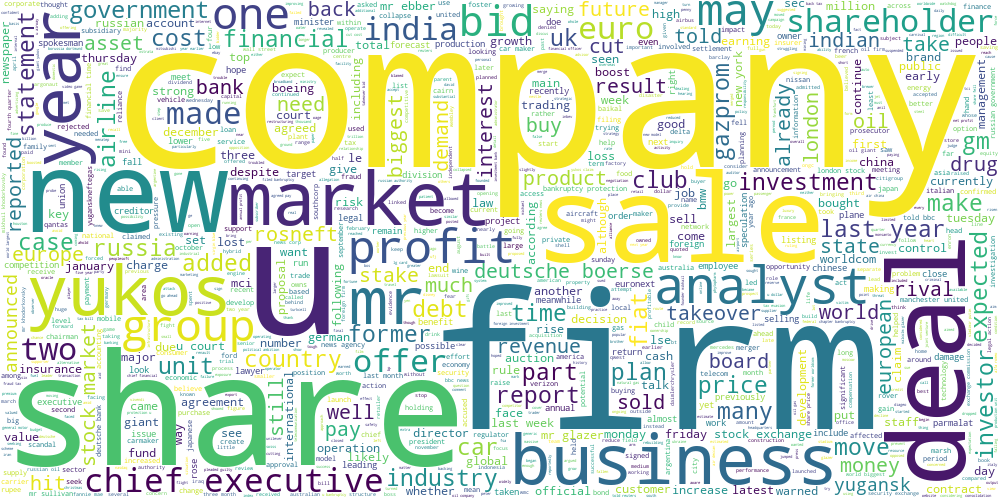

In [30]:
draw_wordcloud(data['text'][kmeans_pred == 6])

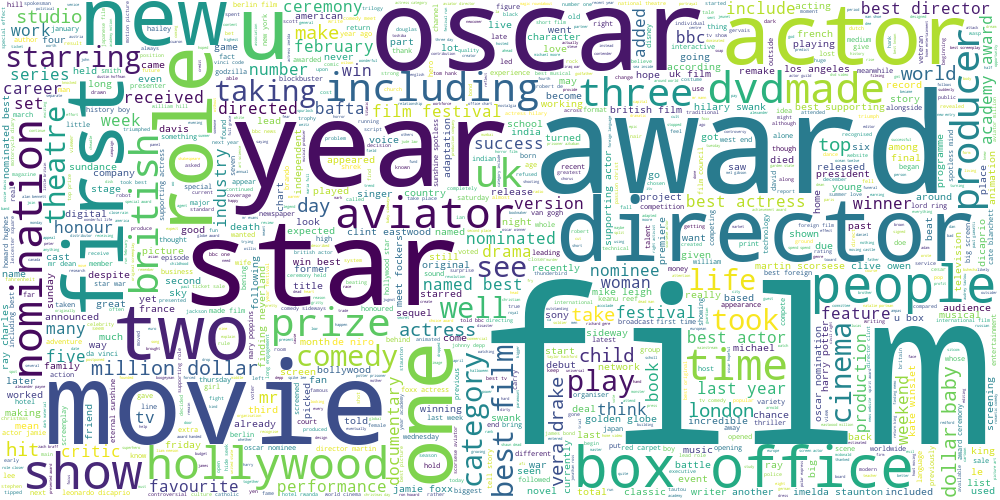

In [31]:
draw_wordcloud(data['text'][kmeans_pred == 7])

**Ваш ответ здесь:** Темы получились хорошо интерпретируемыми.\
0 - политика\
1 - экономика\
2 - технологии\
3 - музыка \
4 - политика \
5 - спорт \
6 - бизнес \
7 - кино

-----

**Задание 2.2 (0.5 балла).** Попробуем другой способ выделить ключевые слова для каждой темы. Помимо непосредственного разбиения объектов алгоритм K-Means получает центр каждого кластера (`kmeans.cluster_centers_`). 

* **(0.3 балла)** Попробуйте взять центры кластеров и посмотреть на слова, для которых значения соответствующих им признаков tf-idf максимальны.
* **(0.2 балла)** (?) Согласуются ли полученные слова с облаками тегов из прошлого задания?

In [50]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
names = np.array(vectorizer.get_feature_names())
centers = np.argmax(kmeans.cluster_centers_, axis=1)
names[centers]

array(['mr', 'economy', 'mobile', 'music', 'mr', 'game', 'company',
       'film'], dtype='<U14')

**Ваш ответ здесь:** Названия согласуются. mr - обращение, чаще употребляется в политике; economy - совпадает с темой кластера; mobile - одно из наиболее популярных слов в теме "технологии"; "game", "company", "film" - аналогично для тем "спорт", "бизнес", "кино".

-----

**Задание 2.3 (1.5 балла).** В первой части мы сравнили три разных алгоритма кластеризации на географических данных. Проделаем то же самое для текстовых данных (в качестве признакого описания снова используем tf-idf). 

* п.1 Получите три разбиения на кластеры с помощью алгоритмов K-Means, DBSCAN и спектральной кластеризации. 
 * **(0.3 балла)** При этом для K-Means и спектральной кластеризации возьмите одинаковое небольшое число кластеров;
 * **(0.5 балла)** Подберите параметр `eps` метода DBSCAN так, чтобы получить приблизительно такое же число кластеров.
* п.2 **(0.5 балла)** Обучите двухмерные t-SNE ([Почитать можно тут, часть 2](https://github.com/esokolov/ml-course-hse/blob/master/2020-fall/lecture-notes/lecture11-unsupervised.pdf), а также посмотреть непосредственно в [sklearn](https://scikit-learn.org/stable/modules/generated/sklearn.manifold.TSNE.html)) представления над tf-idf признаками текстов. Визуализируйте эти представления для каждого алгоритма, раскрасив каждый кластер своим цветом.
* п.3 **(0.2 балла)** (?) Прокомментируйте получившиеся результаты. (?) Какой баланс кластеров получился у разных методов? (?) Соотносятся ли визуализации для текстов с визуализациями для географических данных?


**Замечания:**
* В этом задании используйте реализации спектральной кластеризации и t-SNE из `sklearn`
* В п.2 Лучше всего расположить визуализации на одном графике на трех разных сабплотах. 

**Подсказка:**
* Не забудьте, что DBSCAN помечает некоторые точки как шумовые (можно раскрасить их в отдельный цвет).

In [59]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
kmeans = KMeans()
kmeans_pred = kmeans.fit_predict(texts)

In [64]:
spectral = SpectralClustering()
spect_pred = spectral.fit_predict(texts)

In [90]:
epss = []
eps_list = np.linspace(0.00001, 3, 3000)
for e in tqdm(eps_list):
    db = DBSCAN(eps=e)
    db_pred = db.fit_predict(texts)
    if len(np.unique(db_pred[db_pred != -1])) >= 7 and len(np.unique(db_pred[db_pred != -1])) <= 9 and len(db_pred[db_pred == -1]) < len(db_pred[db_pred != -1]):
        epss.append(e)

100%|██████████| 3000/3000 [14:24<00:00,  3.47it/s]


In [91]:
epss

[1.1133774124708236, 1.1143777425808603]

In [98]:
db = DBSCAN(eps=1.1133774124708236)
db_pred = db.fit_predict(texts)

In [104]:
np.unique(db_pred)

array([-1,  0,  1,  2,  3,  4,  5,  6], dtype=int64)

In [72]:
tsne = TSNE()
transf_texts = tsne.fit_transform(texts)

In [73]:
colors = ['blue', 'orange', 'green', 'red', 'purple', 'brown', 'pink', 'olive', 'gray']

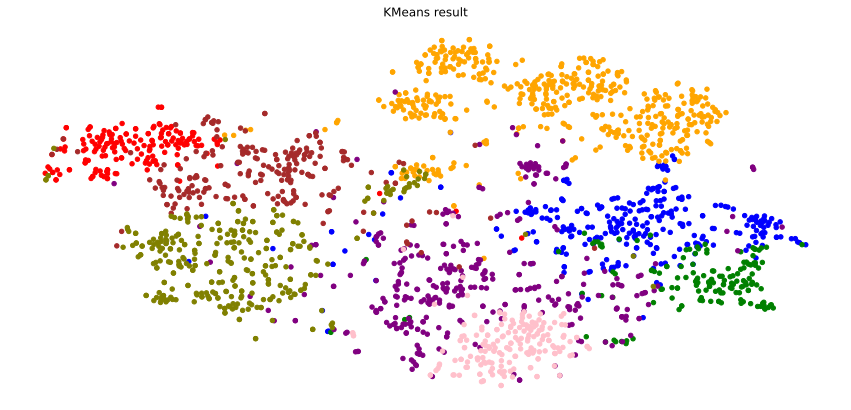

In [77]:
fig = plt.figure(figsize=(15,7))
for i in range(8):
    plt.scatter(transf_texts[:, 0][kmeans_pred == i], transf_texts[:, 1][kmeans_pred == i], c=colors[i], s=20)
plt.axis('off')
plt.title('KMeans result')
plt.show()

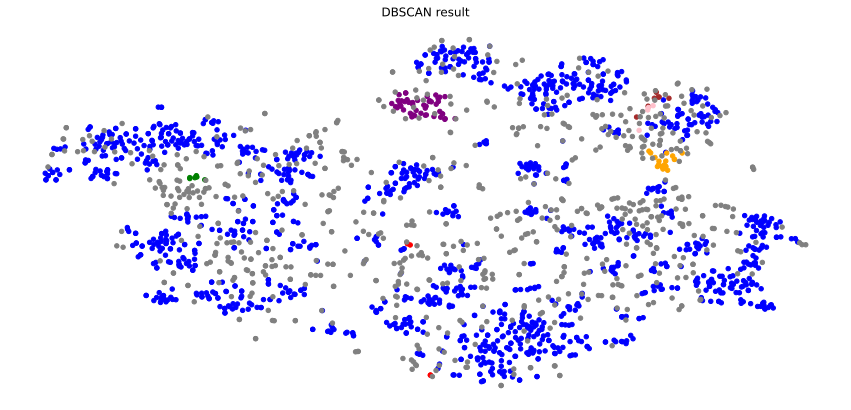

In [100]:
fig = plt.figure(figsize=(15,7))
for i in range(8):
    plt.scatter(transf_texts[:, 0][db_pred == i], transf_texts[:, 1][db_pred == i], c=colors[i], s=20)
plt.scatter(transf_texts[:, 0][db_pred == -1], transf_texts[:, 1][db_pred == -1], c=colors[-1], s=20)
plt.axis('off')
plt.title('DBSCAN result')
plt.show()

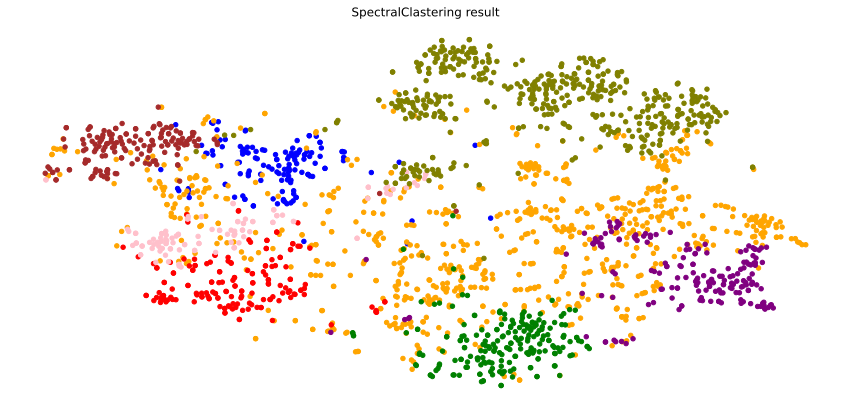

In [101]:
fig = plt.figure(figsize=(15,7))
for i in range(8):
    plt.scatter(transf_texts[:, 0][spect_pred == i], transf_texts[:, 1][spect_pred == i], c=colors[i], s=20)
plt.axis('off')
plt.title('SpectralClastering result')
plt.show()

**Ваш ответ здесь:** У KMeans и спекратльной кластеризации классы получились в целом сбалансированные и, более того, кластеризация у них получилась похожая. У DBSCAN классы не сбалансированные, очень много шумовых объектов, среди оставшихся классов очень сильно выделяется синий, в то время как остальные классы состоят из очень малого числа объектов.\
По сравнению с кластеризацией остановок кластеризация текстов больше похожа на кучки, но все равно можно заметить, что структура таких кучек не оченб шарообразная, она немного сложнее.

-----

**Задание 2.4 (1.5 балла).** 

* **(0.5 балла)**  Обучите модель латентного размещения Дирихле (LDA).
* **(0.5 балла)**  Придумайте как превратить распределение тем для текста в номер его кластера. Опишите текстом (?) и приведите код и результаты его работы
* **(0.5 балла)** Возьмите параметр `n_components` у LDA в 2-3 раза больше, чем число кластеров для K-Means, и вновь посмотрите на темы. (?) Получились ли темы более узкими от такого нововведения? Постройте облака тегов для нескольких наиболее удачных тем.

**Замечания:**
* Реализацию LDA во всех заданиях используйте из `sklearn` (LatentDirichletAllocation)

**Подсказка:**
* Не забудьте, что LDA работает с мешком слов, а не с tf-idf признаками.

**Ключевые слова:**
* *CountVectorizer,  LatentDirichletAllocation*

In [10]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
vectorizer = CountVectorizer()
text_freq = vectorizer.fit_transform(data.text)
lda = LDA(n_components=8)
lda_pred = lda.fit_transform(text_freq)

Чтобы кластеризовать объект, будем смотреть, какая тема встречается в нем чаще всего.

In [114]:
pred = np.argmax(lda_pred, axis=1)

Визуализируем результат

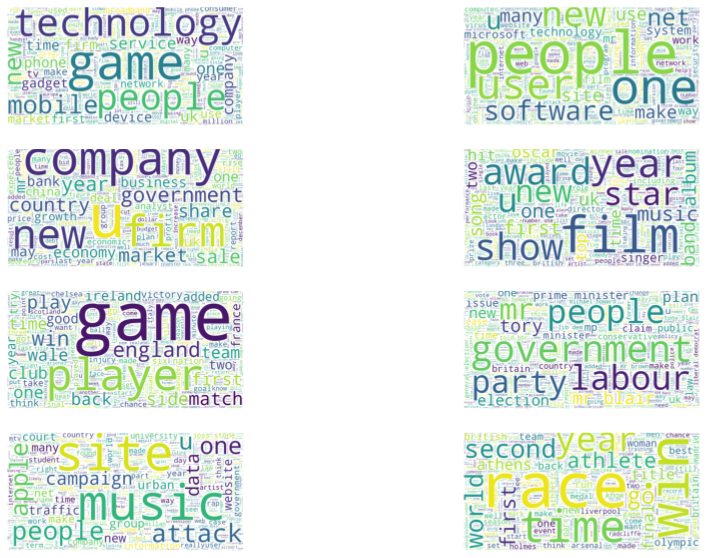

In [116]:
fig = plt.figure(figsize=(15,10))
for i in range(8):
    ax = fig.add_subplot(4, 2, i+1)
    img = draw_wordcloud(data['text'][pred == i])
    plt.axis('off')
    plt.imshow(img)
plt.show()

В целом, кластеризация неплохая, по словам можно догадаться, о чем идет речь в теме. Но некоторые слова в теме явно "пришли" из других тем...

In [117]:
lda = LDA(n_components=14)
lda_pred = lda.fit_transform(text_freq)

In [118]:
pred = np.argmax(lda_pred, axis=1)

In [119]:
for i in range(14):
    print(i, ':', data['text'][pred == i].shape[0])

0 : 84
1 : 85
2 : 40
3 : 210
4 : 66
5 : 37
6 : 236
7 : 123
8 : 175
9 : 29
10 : 222
11 : 269
12 : 404
13 : 245


Видно, что классы получились не совсем сбалансированные. Посмотрим, какие темы удалось выделить.

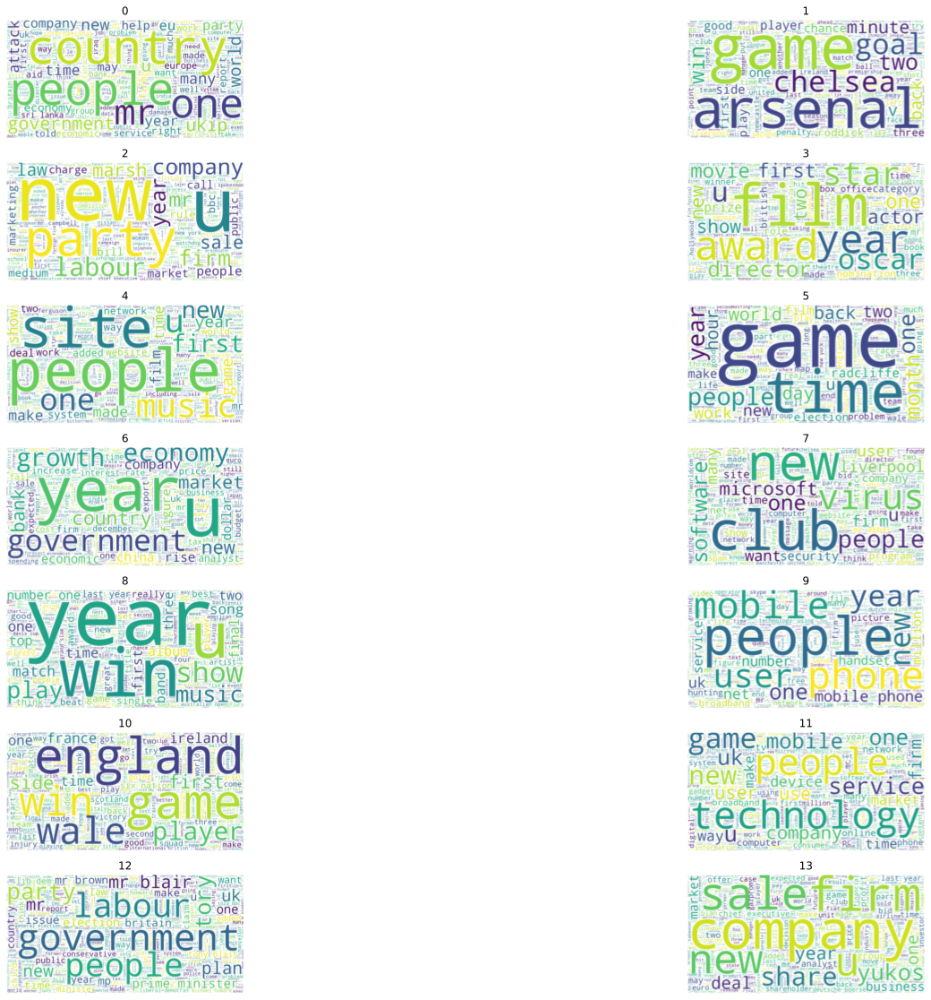

In [122]:
fig = plt.figure(figsize=(25,20))
for i in range(14):
    ax = fig.add_subplot(7, 2, i+1)
    ax.set_title(str(i))
    img = draw_wordcloud(data['text'][pred == i])
    plt.axis('off')
    plt.imshow(img)
plt.show()

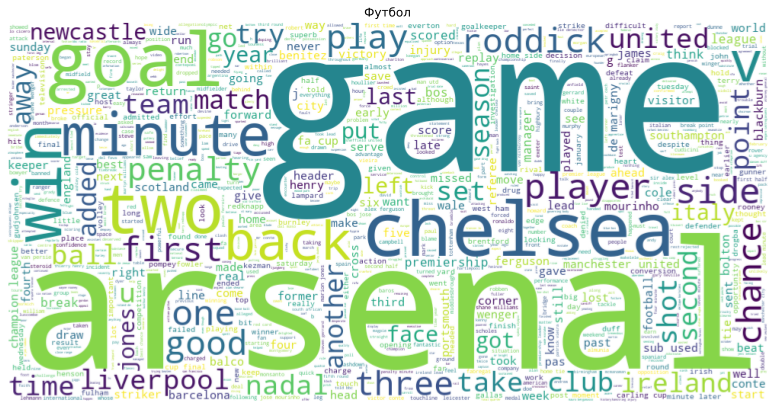

In [123]:
fig = plt.figure(figsize=(15,7))
img = draw_wordcloud(data['text'][pred == 1])
plt.axis('off')
plt.imshow(img)
plt.title('Футбол')
plt.show()

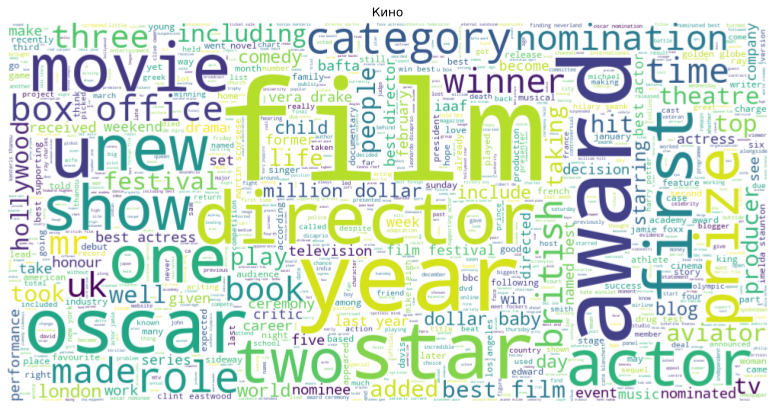

In [124]:
fig = plt.figure(figsize=(15,7))
img = draw_wordcloud(data['text'][pred == 3])
plt.axis('off')
plt.imshow(img)
plt.title('Кино')
plt.show()

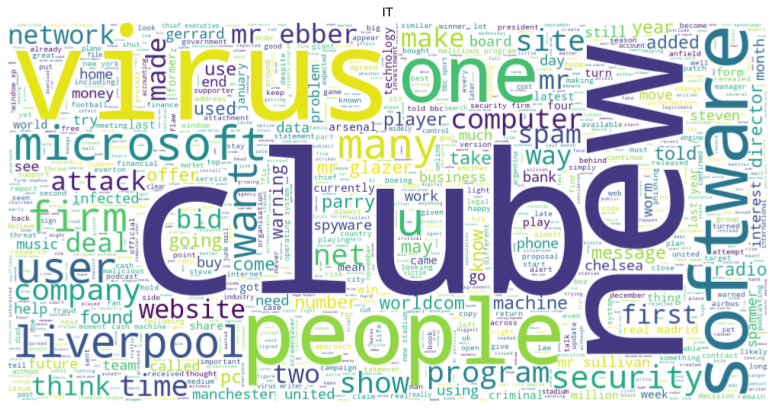

In [125]:
fig = plt.figure(figsize=(15,7))
img = draw_wordcloud(data['text'][pred == 7])
plt.axis('off')
plt.imshow(img)
plt.title('IT')
plt.show()

**Ваш ответ здесь:**  Да, после введения большего числа компонент, темы стали более узкими (например, спорт разделился на несколько направлений). Кластеризация стала точнее, но она все равно проигрывает алгоритмам класеризации, рассмотренным выше (так как почти в каждой теме видны "чужие" слова).

-----

## Часть 3. Transfer learning для задачи классификации текстов

**Замечание для всей части 3:**
* Для возможности получения **полного балла** accuracy всех алгоритмов на тесте должны быть не ниже 0.75, а также хотя бы один из рассмотренных в этой части алгоритмов должен достигнуть точности не менее 0.95 на тесте.

**Задание 3.1 (0.5 балла).** Вспомним, что у нас есть разметка для тематик статей 🌚🌝. Попробуем обучить классификатор поверх unsupervised-представлений для текстов. Рассмотрите три модели:

* Логистическая регрессия на tf-idf признаках
* K-Means на tf-idf признаках + логистическая регрессия на расстояниях до центров кластеров
* Латентное размещение Дирихле + логистическая регрессия на вероятностях тем

* **(0.4 балла)** Разделите выборку на обучающую и тестовую, замерьте accuracy на обоих выборках для всех трех моделей. Параметры всех моделей возьмите равными значениям по умолчанию.
* **(0.1 балла)** (?) У какой модели получилось лучшее качество? (?) С чем это связано?

**Подсказка:**
* Во второй модели расстояния до центров кластеров можно получиться при помощи метода KMeans.transform

**Ключевые слова:**
* *OrdinalEncoder, TfidfVectorizer, CountVectorizer, train_test_split, KMeans.transform*

In [32]:
X_train, X_test, y_train, y_test = train_test_split(data['text'], data['category'], test_size=0.3)

In [33]:
vectorizer = TfidfVectorizer(min_df=50)
vect_X_train = vectorizer.fit_transform(X_train)
vect_X_test = vectorizer.transform(X_test)

In [42]:
vect_X_train.shape

(1557, 987)

In [34]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
logreg = LogisticRegression()
logreg.fit(vect_X_train, y_train)
logreg_pred = logreg.predict(vect_X_test)
print("LogisticRegression accuracy :", y_test[y_test == logreg_pred].shape[0] / y_test.shape[0])

LogisticRegression accuracy : 0.9655688622754491


In [36]:
kmeans = KMeans()
kmeans.fit(vect_X_train)
transformed_train = kmeans.transform(vect_X_train)
transformed_test = kmeans.transform(vect_X_test)
logreg.fit(transformed_train, y_train)
transformed_pred = logreg.predict(transformed_test)
print("TfIdf + LogisticRegression accuracy :", y_test[y_test == transformed_pred].shape[0] / y_test.shape[0])

TfIdf + LogisticRegression accuracy : 0.9191616766467066


C:\Users\Diana\anaconda3\lib\site-packages\sklearn\linear_model\_logistic.py:763: ConvergenceWarning: lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [41]:
vectorizer = CountVectorizer()
transformed_train = vectorizer.fit_transform(X_train)
transformed_test = vectorizer.transform(X_test)
lda = LDA()
lda_train = lda.fit_transform(transformed_train)
lda_test = lda.transform(transformed_test)
logreg.fit(lda_train, y_train)
lda_pred = logreg.predict(lda_test)
print("LDA + LogisticRegression accuracy :", y_test[y_test == lda_pred].shape[0] / y_test.shape[0])

LDA + LogisticRegression accuracy : 0.937125748502994


In [44]:
lda_train.shape

(1557, 10)

**Ваш ответ здесь:** Лучшее качество получилось у логистической регрессии на tf-idf признаках. Лучше 2 модели оно получилось, вероятно, из-за отстутствия у нее нормализации (а, как мы знаем, KMeans чувствителен к масштабированию). Предположение, почему первая модель лучше третьей, такое: логистическая регрессия первой модели обучается на 987 признаках, а лостическая регрессия третьей - на 10, но чем больше размерность признакового пространства, тем выше вероятность, что выборка окажется линейно разделимой.

-----

**Задание 3.2 (1.5 балла).** Теперь просимулируем ситуацию слабой разметки, которая часто встречается в реальных данных. Разделим обучающую выборку в пропорции 5:65:30. Будем называть части, соответственно, размеченный трейн, неразмеченный трейн и валидация.

Все unsupervised-алгоритмы (векторайзеры (tf-idf, bag_of_words) и алгоритмы кластеризации (KMeans)) запускайте на всем трейне целиком (размеченном и неразмеченном, суммарно 70%), а итоговый классификатор обучайте только на размеченном трейне (5%).

* **(1.2 балла)** Подберите гиперпараметры моделей по качеству на валидации (30%), а затем оцените качество на тестовой выборке (которая осталась от прошлого задания). Не скромничайте при подборе числа кластеров, сейчас нас интересует не интерпретируемое разбиение выборки, а итоговое качество классификации. 
* **(0.3 балла)** (?) Как изменились результаты по сравнению с обучением на полной разметке? (?) Сделайте выводы.

**Пояснение:**
* Тестовую выборку возьмите из задания 3.1. А разделять надо тренировочную из 3.1
* Обучаете векторайзер на 70%, применяете векторайзер к 5%, и на этих 5% уже обучаете классификатор.
* Итак, берем 3 варианта обучения из задания 3.1. Вы должны:
 * 1-я модель. Подобрать оптимальный гиперпараметр С у LogisticRegression на tf-idf признаках. Выбираем оптимальный параметр по валидационной выборке. Далее оцениваем обученную модель с оптимальном параметром на тесте.
 * 2-я модель. Шаг 1. Подобрать оптимальный гиперпараметр n_clusters у KMeans на tf-idf признаках: перебираем значения n_clusters и при каждом значении обучаем LogisticRegression на дефолтных параметрах (быть может с ограничением max_iter, об этом ниже). То есть классификатор в данном случае будет на одинаковых параметрах для всех представителей семейства алгоритмов KMeans. Далее выбираете оптимальный n_clusters по качеству классификатора на валидационной выборке. Шаг 2. Обучаете KMeans с оптимальным n_clusters и перебираете значение C у LogisticRegression. Также выбираете оптмальное по валидации. И только после двух подобранных оптимальных параметров выводите качество на тесте.
 * 3-я модель. Аналогично второй, только вместо KMeans --- LatentDirichletAllocation, а вместо tf-idf -- bag of words.

**Замечания:**
* Параметр $С$ у LogisticRegression перебирайте *по логарифмической сетке.* Обратите внимание, что $С$ НЕ перед регуляризатором, поэтому, скорее всего, наиболее оптимальными будут большие значения $C$. **Для возможности получения полного балла** переберите хотя бы 20 параметров, и затроньте значения в 1e-2 и 1e6 (по большей части значения должны лежать в этом отрезке)
* **Для возможности получения полного балла** параметр n_clusters у KMeans при переборе должен затрагивать значения в 10 и 1000 кластеров (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не менее 20 значений кластеров *(по линейной сетке)*
* **Для возможности получения полного балла** параметр n_components у LDA при переборе должен затрагивать значения в 5 и 14 (по большей части значения должны лежать в этом отрезке), а также должно быть перебрано не меньше 10 различных значений *(по линейной сетке)*

**Подсказка:**
* Может быть для ограничения времени обучения лучше будет ограничить параметр max_iter в LogisticRegression, равным, например, 1000

In [45]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿
X_train, X_val, y_train, y_val = train_test_split(X_train, y_train, test_size=0.3)
labeled_train, unlabeled_train, labeled_y, unlabeled_y = train_test_split(X_train, y_train, test_size=0.65 * 10 / 7)

In [64]:
vectorizer = TfidfVectorizer(min_df=50)
vect_train = vectorizer.fit_transform(X_train)
vect_X_train = vectorizer.transform(labeled_train)
vect_X_test = vectorizer.transform(X_val)

In [65]:
vect_test = vectorizer.transform(X_test)

In [66]:
c_list = np.logspace(-3, 7, num = 20, endpoint=True, base = np.e)

In [67]:
acc1 = []
opt_model = None
best_acc = 0
for c in c_list:
    logreg = LogisticRegression(C=c, max_iter=1000)
    logreg.fit(vect_X_train, labeled_y)
    logreg_pred = logreg.predict(vect_X_test)
    cur_acc = y_val[y_val == logreg_pred].shape[0] / y_val.shape[0]
    print(c, ":", cur_acc)
    acc1.append(cur_acc)
    if cur_acc > best_acc:
        opt_model = logreg
        best_acc = cur_acc

0.04978706836786395 : 0.22008547008547008
0.08427380392170364 : 0.2222222222222222
0.14264897010923278 : 0.25427350427350426
0.24145971495638435 : 0.4337606837606838
0.40871514110598395 : 0.6217948717948718
0.691825825270517 : 0.7222222222222222
1.1710429205438226 : 0.7905982905982906
1.9822063179263145 : 0.8397435897435898
3.3552501090244724 : 0.8717948717948718
5.679380189790729 : 0.8846153846153846
9.613399386660182 : 0.8824786324786325
16.27245309859133 : 0.8824786324786325
27.5441307695266 : 0.8824786324786325
46.62352598296678 : 0.8824786324786325
78.91892444430691 : 0.8867521367521367
133.58484808123697 : 0.8888888888888888
226.11701518411238 : 0.8888888888888888
382.7447894740212 : 0.8888888888888888
647.8662109980196 : 0.8888888888888888
1096.6331584284583 : 0.8910256410256411


In [68]:
pred = opt_model.predict(vect_test)
print("1 model accuracy :", y_test[y_test == pred].shape[0] / y_test.shape[0])

1 model accuracy : 0.9116766467065869


In [71]:
n_clusters = np.arange(10, 1020, 50)
opt_clusters = 0
best_acc = 0
for n in n_clusters:
    kmeans = KMeans(n_clusters=n)
    kmeans.fit(vect_train)
    transformed_train = kmeans.transform(vect_X_train)
    transformed_test = kmeans.transform(vect_X_test)
    logreg = LogisticRegression(max_iter=1000)
    logreg.fit(transformed_train, labeled_y)
    transformed_pred = logreg.predict(transformed_test)
    cur_acc = y_val[y_val == transformed_pred].shape[0] / y_val.shape[0]
    print(n, ":", cur_acc)
    acc1.append(cur_acc)
    if cur_acc > best_acc:
        best_acc = cur_acc
        opt_clusters = n

10 : 0.48504273504273504
60 : 0.7457264957264957
110 : 0.8247863247863247
160 : 0.8568376068376068
210 : 0.8846153846153846
260 : 0.8888888888888888
310 : 0.8931623931623932
360 : 0.8995726495726496
410 : 0.8974358974358975
460 : 0.9038461538461539
510 : 0.9123931623931624
560 : 0.9145299145299145
610 : 0.9081196581196581
660 : 0.9102564102564102
710 : 0.905982905982906
760 : 0.905982905982906
810 : 0.9081196581196581
860 : 0.9038461538461539
910 : 0.905982905982906
960 : 0.9102564102564102
1010 : 0.9145299145299145


In [72]:
opt_clusters

560

In [73]:
kmeans = KMeans(n_clusters=opt_clusters)
kmeans.fit(vect_train)
transformed_train = kmeans.transform(vect_X_train)
transformed_test = kmeans.transform(vect_X_test)

In [78]:
ttest = kmeans.transform(vect_test)

In [76]:
opt_model = None
opt_c = 0
best_acc = 0
for c in c_list:
    logreg = LogisticRegression(C=c, max_iter=1000)
    logreg.fit(transformed_train, labeled_y)
    transformed_pred = logreg.predict(transformed_test)
    cur_acc = y_val[y_val == transformed_pred].shape[0] / y_val.shape[0]
    print(c, ":", cur_acc)
    if cur_acc > best_acc:
        opt_model = logreg
        best_acc = cur_acc
        opt_c = c

0.04978706836786395 : 0.594017094017094
0.08427380392170364 : 0.7051282051282052
0.14264897010923278 : 0.7649572649572649
0.24145971495638435 : 0.8376068376068376
0.40871514110598395 : 0.8867521367521367
0.691825825270517 : 0.9038461538461539
1.1710429205438226 : 0.9102564102564102
1.9822063179263145 : 0.9166666666666666
3.3552501090244724 : 0.9188034188034188
5.679380189790729 : 0.9188034188034188
9.613399386660182 : 0.9188034188034188
16.27245309859133 : 0.9188034188034188
27.5441307695266 : 0.9188034188034188
46.62352598296678 : 0.9188034188034188
78.91892444430691 : 0.9166666666666666
133.58484808123697 : 0.9166666666666666
226.11701518411238 : 0.9166666666666666
382.7447894740212 : 0.9188034188034188
647.8662109980196 : 0.9188034188034188
1096.6331584284583 : 0.9209401709401709


In [77]:
opt_c

1096.6331584284583

In [79]:
pred = opt_model.predict(ttest)
print("2 model accuracy :", y_test[y_test == pred].shape[0] / y_test.shape[0])

2 model accuracy : 0.9326347305389222


In [80]:
vectorizer = CountVectorizer(min_df=50)
vect_train = vectorizer.fit_transform(X_train)
vect_X_train = vectorizer.transform(labeled_train)
vect_X_test = vectorizer.transform(X_val)
vect_test = vectorizer.transform(X_test)

In [83]:
n_comps = np.arange(5, 15)
opt_comps = 0
best_acc = 0
for n in n_comps:
    lda = LDA(n_components=n)
    lda.fit(vect_train)
    transformed_train = lda.transform(vect_X_train)
    transformed_test = lda.transform(vect_X_test)
    logreg = LogisticRegression(max_iter=1000)
    logreg.fit(transformed_train, labeled_y)
    transformed_pred = logreg.predict(transformed_test)
    cur_acc = y_val[y_val == transformed_pred].shape[0] / y_val.shape[0]
    print(n, ":", cur_acc)
    if cur_acc > best_acc:
        best_acc = cur_acc
        opt_comps = n

5 : 0.7670940170940171
6 : 0.9209401709401709
7 : 0.9038461538461539
8 : 0.9273504273504274
9 : 0.9294871794871795
10 : 0.8974358974358975
11 : 0.9230769230769231
12 : 0.844017094017094
13 : 0.8952991452991453
14 : 0.8632478632478633


In [84]:
opt_comps

9

In [85]:
lda = LDA(n_components=opt_comps)
lda.fit(vect_train)
transformed_train = lda.transform(vect_X_train)
transformed_test = lda.transform(vect_X_test)
ttest = lda.transform(vect_test)

In [89]:
opt_model = None
opt_c = 0
best_acc = 0
for c in c_list:
    logreg = LogisticRegression(C=c, max_iter=1000)
    logreg.fit(transformed_train, labeled_y)
    transformed_pred = logreg.predict(transformed_test)
    cur_acc = y_val[y_val == transformed_pred].shape[0] / y_val.shape[0]
    print(c, ":", cur_acc)
    if cur_acc > best_acc:
        opt_model = logreg
        best_acc = cur_acc
        opt_c = c

0.04978706836786395 : 0.3995726495726496
0.08427380392170364 : 0.6581196581196581
0.14264897010923278 : 0.7542735042735043
0.24145971495638435 : 0.8247863247863247
0.40871514110598395 : 0.8547008547008547
0.691825825270517 : 0.8760683760683761
1.1710429205438226 : 0.8910256410256411
1.9822063179263145 : 0.9038461538461539
3.3552501090244724 : 0.9123931623931624
5.679380189790729 : 0.9209401709401709
9.613399386660182 : 0.9188034188034188
16.27245309859133 : 0.9294871794871795
27.5441307695266 : 0.9294871794871795
46.62352598296678 : 0.9273504273504274
78.91892444430691 : 0.9294871794871795
133.58484808123697 : 0.9252136752136753
226.11701518411238 : 0.9230769230769231
382.7447894740212 : 0.9252136752136753
647.8662109980196 : 0.9188034188034188
1096.6331584284583 : 0.9145299145299145


In [90]:
opt_c

16.27245309859133

In [92]:
pred = opt_model.predict(ttest)
print("3 model accuracy :", y_test[y_test == pred].shape[0] / y_test.shape[0])

3 model accuracy : 0.9326347305389222


**Ваш ответ здесь:** несмотря на то, что обучение производилось на неполной выборке, качество осталось хорошим. При этом логистическая регрессия на tf-ifd признаках стала работать хуже (хотя в прошлом задании именно у нее было лучшее качество), подход с kmeans стал работать, наоборот, лучше, а у модели с использованием LDA качество осталось прежним. Такие изменения могут быть связаны не только с обучением на неполной выборке, но и с более тщательным подбором гиперпараметров.

-----

## Бонус

**Задание 4 (1 балл)**. 

* **(Максимум 0.8 балла, 0.4 балла за каждый исследованный метод)** Разберитесь с semi-supervised методами, которые реализованы в `sklearn` и примените их к заданию 3.2. 
* **(0.2 балла)** (?) Получилось ли добиться лучшего качества? (?) Сделайте выводы.

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 5 (1 балл)**. Существует метрика BCubed ([Ссылка 1](https://github.com/esokolov/ml-course-hse/blob/master/2020-spring/lecture-notes/lecture17-clusterization.pdf), [Ссылка 2](https://www.researchgate.net/profile/Julio-Gonzalo-2/publication/225548032_Amigo_E_Gonzalo_J_Artiles_J_et_alA_comparison_of_extrinsic_clustering_evaluation_metrics_based_on_formal_constraints_Inform_Retriev_12461-486/links/0c96052138dbb99740000000/Amigo-E-Gonzalo-J-Artiles-J-et-alA-comparison-of-extrinsic-clustering-evaluation-metrics-based-on-formal-constraints-Inform-Retriev-12461-486.pdf)), которая хорошо подходит для сравнения алгоритмов кластеризации, если нам известно настоящее разделение на кластеры (gold standard). 

* **(0.2 балла)** Реализуйте подсчет метрики BCubed
* **(0.8 балла)** (?) Сравните несколько алгоритмов кластеризации на текстовых данных из основного задания. В качестве gold standard используйте разметку category.

**Замечание:**
* Пользоваться готовыми библиотечными методами для вычисления BCubed нельзя

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Ваш ответ здесь:**

**Задание 6 (2 баллa)**. Спектральная кластеризация, по сути, является обычной кластеризацией KMeans поверх эмбеддингов объектов, которые получаются из лапласиана графа. А что, если мы попробуем построить эмбеддинги каким-нибудь другим способом? В этом задании мы предлагаем вам проявить немного фантазии🧙.

* Возьмите какие-нибудь данные высокой размерности, чтобы задача обучения эмбеддингов имела смысл (например, картинки или тексты, желательно выбрать что-нибудь оригинальное). (?) Напишите, откуда брали данные и что это за данные
* **(1.7 балла)** Придумайте или найдите какой-нибудь метод обучения эмбеддингов, примените его к данным и кластеризуйте полученные представления. Если чувствуете в себе достаточно силы, можете попробовать что-нибудь нейросетевое.
* **(0.3 балла)** (?) Сравните ваш подход с базовыми алгоритмами кластеризации, которое мы рассмотрели в основном задании, не забывайте про визуализации! 

**Подсказка:**
* Ключевые слова для вдохновения: ***KernelPCA***, ***UMAP***, ***autoencoders***, ***gensim***. 

In [ ]:
# YOUR CODE HERE ‿︵‿︵ヽ(°□° )ノ︵‿︵‿

**Задание 7 (0.1 балла)**. Опишите свои ощущения от этой домашки🥔

In [ ]:
# YOUR CODE HERE (ノಠ益ಠ)ノ彡┻━┻